See https://github.com/genkuroki/public/blob/main/0045/Welch%20t%2C%20Student%2C%20Wilcoxon-Mann-Whitney%2C%20and%20Brunner-Munzel.ipynb

In [1]:
using Random
Random.seed!(4649373)

using Distributions
using QuadGK
using Roots
using StatsPlots
default(fmt=:png)

function winningrate(
        distx::ContinuousUnivariateDistribution,
        disty::ContinuousUnivariateDistribution
    )
    quadgk(y -> cdf(distx, y)*pdf(disty, y), extrema(disty)...)[1]
end

function tieshift(
        distx::ContinuousUnivariateDistribution,
        disty::ContinuousUnivariateDistribution;
        p = 1/2
    )
    find_zero(0.0) do a
        winningrate(distx + a, disty) - p
    end
end

@show distx = Exponential(1)
@show disty = Exponential(1.5)
@show winningrate(distx, disty)
println()
@show tiesh = tieshift(distx, disty)
@show mediansh = median(disty) - median(distx)
@show meansh = mean(disty) - mean(distx)
println()
@show winningrate(distx + tiesh, disty)
@show winningrate(distx + mediansh, disty)
@show winningrate(distx + meansh, disty)
println()
@show median(distx + tiesh)
@show median(distx + mediansh)
@show median(distx + meansh)
@show median(disty)
println()
@show mean(distx + tiesh)
@show mean(distx + mediansh)
@show mean(distx + meansh)
@show mean(disty)
;

distx = Exponential(1) = Exponential{Float64}(θ=1.0)
disty = Exponential(1.5) = Exponential{Float64}(θ=1.5)
winningrate(distx, disty) = 0.6000000000000003

tiesh = tieshift(distx, disty) = 0.27348233139104033
mediansh = median(disty) - median(distx) = 0.3465735902799726
meansh = mean(disty) - mean(distx) = 0.5

winningrate(distx + tiesh, disty) = 0.5
winningrate(distx + mediansh, disty) = 0.47622031634305906
winningrate(distx + meansh, disty) = 0.4299187894696709

median(distx + tiesh) = 0.9666295119509856
median(distx + mediansh) = 1.0397207708399179
median(distx + meansh) = 1.1931471805599454
median(disty) = 1.0397207708399179

mean(distx + tiesh) = 1.2734823313910404
mean(distx + mediansh) = 1.3465735902799727
mean(distx + meansh) = 1.5
mean(disty) = 1.5


In [2]:
using Distributions

@doc raw"""
    brunner_munzel_test(X, Y; p = 1/2)

この函数は数値のベクトルのデータ `X`, `Y` について, Brunner-Munzel検定関係の統計量達を計算する. 詳細は以下の通り.

函数 $H(x, y)$ と $\hat{p}$, $H^x_i$, $H^y_j$, $\bar{H}^x$, $\bar{H}^y$ を次のように定める:

```math
\begin{aligned}
&
m = \mathrm{length}(X), \quad
n = \mathrm{length}(Y), \quad
x_i = X[i], \quad
y_j = Y[j],
\\ &
\hat{p} = \frac{1}{mn}\sum_{i=1}^m \sum_{j=1}^n H(x_i, y_j),
\\ &
H(x, y) = \begin{cases} 1 & (x < y) \\ 1/2 & (x = y) \\ 0 & (x > y), \end{cases}
\\ &
H^x_i = \sum_{j=1}^n H(y_j, x_i), \quad
H^y_j = \sum_{i=1}^m H(x_i, y_j),
\\ &
\bar{H}^x = \frac{1}{m} \sum_{i=1}^m H^x_i = n - n\hat{p}, \quad
\bar{H}^y = \frac{1}{n} \sum_{j=1}^n H^y_j = m\hat{p}.
\end{aligned}
```

この函数は以下達の named tuple で返す:

```math
\begin{aligned}
&
\mathrm{phat} = 
\hat{p} = \frac{\bar{H}^y - \bar{H}^x + n}{m + n},
\\ &
\mathrm{sx2} =
\hat{\sigma}_x^2 = \frac{1}{n^2}\frac{1}{m-1}\sum_{i=1}^m (H^x_i - \bar{H}^x)^2,
\\ &
\mathrm{sy2} =
\hat{\sigma}_y^2 = \frac{1}{m^2}\frac{1}{n-1}\sum_{j=1}^n (H^y_j - \bar{H}^y)^2,
\\ &
\mathrm{sehat} = 
\widehat{\mathrm{se}} = \sqrt{\frac{\hat{\sigma}_x^2}{m} + \frac{\hat{\sigma}_y^2}{n}}, 
\\ &
\mathrm{tvalue} = t = \frac{\hat{p} - p}{\widehat{\mathrm{se}}},
\\ &
\mathrm{df} =
\nu = 
\frac
{\left(\hat{\sigma}_x^2/m + \hat{\sigma}_y^2/n\right)^2}
{
\dfrac{\left(\hat{\sigma}_x^2/m\right)^2}{m-1} +
\dfrac{\left(\hat{\sigma}_y^2/n\right)^2}{n-1}
},
\\ &
\mathrm{pvalue} =
2\mathrm{ccdf}(\mathrm{TDist}(\nu), |t|),
\\ &
\mathrm{p} = p.
\end{aligned}
```
"""
function brunner_munzel_test(X, Y; p=1/2)
    m, n = length(X), length(Y)
    phat = mean((x < y) + (x == y)/2 for x in X, y in Y)
    Hbarx = n*(1 - phat)
    Hbary = m*phat
    sx2 = 1/n^2 * 1/(m-1) * sum(x -> (sum((y < x) + (y == x)/2 for y in Y) - Hbarx)^2, X)
    sy2 = 1/m^2 * 1/(n-1) * sum(y -> (sum((x < y) + (x == y)/2 for x in X) - Hbary)^2, Y)
    sehat = √(sx2/m + sy2/n)
    tvalue = (phat - p)/sehat
    df = (sx2/m + sy2/n)^2 / ((sx2/m)^2/(m-1) + (sy2/n)^2/(n-1))
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; phat, sehat, tvalue, df, pvalue, p)
end

@doc raw"""
    pvalue_brunner_munzel_test(X, Y; p = 1/2)

この函数はBrunner-Munzel検定のP値 `pvalue` を返す.
"""
pvalue_brunner_munzel_test(X, Y; p=1/2) = brunner_munzel_test(X, Y; p).pvalue

using RCall
@rimport lawstat
X = rand(100)
Y = rand(100)
pvalue_brunner_munzel_test(X, Y), rcopy(lawstat.brunner_munzel_test(X, Y))[:p_value]

(0.10237071161776065, 0.10237071161776079)

In [3]:
@doc brunner_munzel_test

```
brunner_munzel_test(X, Y; p = 1/2)
```

この函数は数値のベクトルのデータ `X`, `Y` について, Brunner-Munzel検定関係の統計量達を計算する. 詳細は以下の通り.

函数 $H(x, y)$ と $\hat{p}$, $H^x_i$, $H^y_j$, $\bar{H}^x$, $\bar{H}^y$ を次のように定める:

$$
\begin{aligned}
&
m = \mathrm{length}(X), \quad
n = \mathrm{length}(Y), \quad
x_i = X[i], \quad
y_j = Y[j],
\\ &
\hat{p} = \frac{1}{mn}\sum_{i=1}^m \sum_{j=1}^n H(x_i, y_j),
\\ &
H(x, y) = \begin{cases} 1 & (x < y) \\ 1/2 & (x = y) \\ 0 & (x > y), \end{cases}
\\ &
H^x_i = \sum_{j=1}^n H(y_j, x_i), \quad
H^y_j = \sum_{i=1}^m H(x_i, y_j),
\\ &
\bar{H}^x = \frac{1}{m} \sum_{i=1}^m H^x_i = n - n\hat{p}, \quad
\bar{H}^y = \frac{1}{n} \sum_{j=1}^n H^y_j = m\hat{p}.
\end{aligned}
$$

この函数は以下達の named tuple で返す:

$$
\begin{aligned}
&
\mathrm{phat} = 
\hat{p} = \frac{\bar{H}^y - \bar{H}^x + n}{m + n},
\\ &
\mathrm{sx2} =
\hat{\sigma}_x^2 = \frac{1}{n^2}\frac{1}{m-1}\sum_{i=1}^m (H^x_i - \bar{H}^x)^2,
\\ &
\mathrm{sy2} =
\hat{\sigma}_y^2 = \frac{1}{m^2}\frac{1}{n-1}\sum_{j=1}^n (H^y_j - \bar{H}^y)^2,
\\ &
\mathrm{sehat} = 
\widehat{\mathrm{se}} = \sqrt{\frac{\hat{\sigma}_x^2}{m} + \frac{\hat{\sigma}_y^2}{n}}, 
\\ &
\mathrm{tvalue} = t = \frac{\hat{p} - p}{\widehat{\mathrm{se}}},
\\ &
\mathrm{df} =
\nu = 
\frac
{\left(\hat{\sigma}_x^2/m + \hat{\sigma}_y^2/n\right)^2}
{
\dfrac{\left(\hat{\sigma}_x^2/m\right)^2}{m-1} +
\dfrac{\left(\hat{\sigma}_y^2/n\right)^2}{n-1}
},
\\ &
\mathrm{pvalue} =
2\mathrm{ccdf}(\mathrm{TDist}(\nu), |t|),
\\ &
\mathrm{p} = p.
\end{aligned}
$$


In [4]:
function mann_whitney_u_test(X, Y; correct=true)
    m, n = length(X), length(Y)
    phat = mean((x < y) + (x == y)/2 for x in X, y in Y)
    sehat = √((m+n+1)/(12m*n))
    zvalue = (phat - 1/2)/sehat
    correction = correct/(2m*n*sehat)
    pvalue = 2ccdf(Normal(), max(0, abs(zvalue) - correction))
    (; phat, sehat, zvalue, pvalue)
end

pvalue_mann_whitney_u_test(X, Y; correct=true) = mann_whitney_u_test(X, Y; correct).pvalue

using HypothesisTests
X = randn(100)
Y = randn(100)
pvalue_mann_whitney_u_test(X, Y), pvalue(ApproximateMannWhitneyUTest(X, Y))

(0.04990007292443201, 0.04990007292443193)

In [5]:
function student_t_test(X, Y; μ = 0.0)
    m, X̄, SX2 = length(X), mean(X), var(X)
    n, Ȳ, SY2 = length(Y), mean(Y), var(Y)
    S2 = ((m-1)*SX2 + (n-1)*SY2) / (m+n-2)
    sehat2 = S2 * (1/m + 1/n)
    tvalue = (X̄ - Ȳ - μ) / √sehat2
    df = m + n - 2
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; pvalue, tvalue, sehat2, df)
end

pvalue_student_t_test(X, Y; μ = 0.0) = student_t_test(X, Y; μ).pvalue

using HypothesisTests
X = randn(100)
Y = randn(100)
pvalue_student_t_test(X, Y), pvalue(EqualVarianceTTest(X, Y))

(0.4389806931272048, 0.4389806931272048)

In [6]:
function welch_t_test(X, Y; μ = 0.0)
    m, X̄, SX2 = length(X), mean(X), var(X)
    n, Ȳ, SY2 = length(Y), mean(Y), var(Y)
    sehat2 = SX2/m + SY2/n
    tvalue = (X̄ - Ȳ - μ) / √sehat2
    df = sehat2^2 / ((SX2/m)^2/(m-1) + (SY2/n)^2/(n-1))
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; pvalue, tvalue, sehat2, df)
end

pvalue_welch_t_test(X, Y; μ = 0.0) =welch_t_test(X, Y; μ).pvalue

using HypothesisTests
X = randn(100)
Y = randn(100)
pvalue_welch_t_test(X, Y), pvalue(UnequalVarianceTTest(X, Y))

(0.7219945156946428, 0.7219945156946428)

In [7]:
"""
gammadist(σ, β)

returns the gamma distribution with standard deviation `σ` and skewness `β`.
"""
gammadist(σ, β) = Gamma(4/β^2, β*σ/2)

gam = gammadist.(1:5, 2:2:10)
std.(gam), skewness.(gam), kurtosis.(gam)

([1.0, 2.0, 3.0, 4.0, 5.0], [2.0, 4.0, 6.0, 8.0, 10.0], [6.0, 24.0, 54.0, 96.0, 150.0])

In [8]:
@doc gammadist

gammadist(σ, β)

returns the gamma distribution with standard deviation `σ` and skewness `β`.


In [9]:
"""
inversegammadist(σ, β)

returns the inverse gamma distribution with standard deviation `σ` and skewness `β`.
"""
function inversegammadist(σ, β)
    γ = 1/β
    α = 3 + 8γ^2 + 4γ * √(1 + 4γ^2)
    θ = σ * (α - 1) * √(α - 2)
    InverseGamma(α, θ)
end

igam = inversegammadist.(1:5, 2:2:10)
std.(igam), skewness.(igam), kurtosis.(igam)

([0.9999999999999999, 2.0, 3.0, 3.9999999999999996, 5.0], [2.0, 4.0, 6.0, 7.999999999999998, 10.0], [9.134446499564898, 72.54101966249682, NaN, NaN, NaN])

In [10]:
@doc inversegammadist

inversegammadist(σ, β)

returns the inverse gamma distribution with standard deviation `σ` and skewness `β`.


In [11]:
function prc(s, x, α)
    if x < α/2
        printstyled(s, x; color=:blue, bold=true)
    elseif x < α/1.3
        printstyled(s, x; color=:blue)
    elseif x < 1.3α
        print(s, x)
    elseif x < 2α
        printstyled(s, x; color=:red)
    else
        printstyled(s, x; color=:red, bold=true)
    end
    println()
end

for k in 0.01:0.01:0.11
    prc("hoge: ", k, 0.05)
end

hoge: 0.01
hoge: 0.02
hoge: 0.03
hoge: 0.04
hoge: 0.05
hoge: 0.06
hoge: 0.07
hoge: 0.08
hoge: 0.09
hoge: 0.1
hoge: 0.11



  0.418197 seconds (4.16 M allocations: 148.616 MiB, 17.16% gc time, 134.82% compilation time)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         0.0         0.0

true α-error rate for α = 0.05
  Welch t-test:        0.08511
  Student t-test:      0.17011
  Brunner-Munzel test: 0.05181
  WMW test:            0.06776



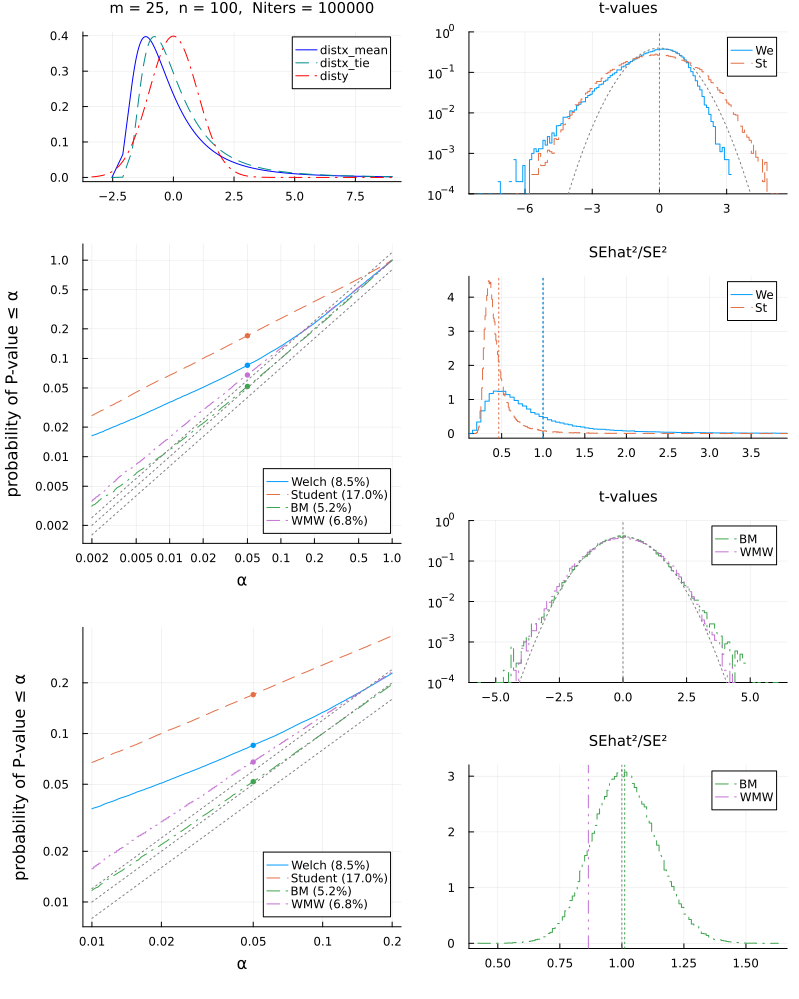

In [58]:
using Printf
undefvector(T::Type, m) = Vector{T}(undef, m)
undefvector(m) = undefvector(Float64, m)
ECDF(A, x) = count(≤(x), A)/length(A)
rd(x) = round(x; digits=1)

function plot_sim(;
        distx = inversegammadist(2, 5),
        disty = Normal(0, 1),
        xlim = :auto,
        ylim = :auto,
        m = 25,
        n = 100,
        L = 10^6,
        shifttype = :auto,
        α = 0.05,
        legend = :bottomright,
        correct = true,
        verbose = false,
    )
    
    tiesh = tieshift(distx, disty)
    mediansh = median(disty) - median(distx)
    meansh = mean(disty) - mean(distx)
    if verbose
        @show tiesh mediansh meansh
    end
    println()
    
    distx_tie = distx + tiesh
    distx_median = distx + mediansh
    distx_mean = distx + meansh
    if shifttype == :tie
        distx = distx_tie
    elseif shifttype == :median
        distx = distx_median
    elseif shifttype == :mean || shifttype == :auto
        distx = distx_mean
    end
    if verbose
        @show shifttype
        @show distx
        @show winningrate(distx, disty)
        @show median(distx) median(disty)
        @show mean(distx) mean(disty)
        println()
    end

    if xlim == :auto
        a = minimum(quantile.((distx_mean, distx_median, distx_tie, disty), 0.01))
        b = maximum(quantile.((distx_mean, distx_median, distx_tie, disty), 0.99))
        l = b - a
        a = a - l/10
        b = b + l/10
    else
        a, b = xlim
    end
    P1 = plot()
    if shifttype == :auto
        plot!(distx_mean, a, b; label="distx_mean", c=:blue)
        plot!(distx_tie, a, b; label="distx_tie", c=:darkcyan, ls=:dash)
    else
        plot!(distx, a, b; label="distx", c=:blue)
    end
    plot!(disty, a, b; label="disty", ls=:dashdot, c=:red)
    plot!(; ylim)
    title!("m = $m,  n = $n,  Niters = $L"; titlefontsize=10)

    pval_we = undefvector(L)
    pval_st = undefvector(L)
    tval_we = undefvector(L)
    tval_st = undefvector(L)
    sehat2_we = undefvector(L)
    sehat2_st = undefvector(L)
    
    pval_bm = undefvector(L)
    pval_mw = undefvector(L)
    tval_bm = undefvector(L)
    tval_mw = undefvector(L)
    sehat2_bm = undefvector(L)
    sehat2_mw = undefvector(L)
    phat = undefvector(L)

    nth = Threads.nthreads()
    Xtmp = [undefvector(m) for _ in 1:nth]
    Ytmp = [undefvector(n) for _ in 1:nth]
    
    @time Threads.@threads for i in 1:L
        tid = Threads.threadid()
        X = rand!(distx, Xtmp[tid])
        Y = rand!(disty, Ytmp[tid])
        we = welch_t_test(X, Y)
        st = student_t_test(X, Y)
        pval_we[i], tval_we[i], sehat2_we[i] = we.pvalue, we.tvalue, we.sehat2
        pval_st[i], tval_st[i], sehat2_st[i] = st.pvalue, st.tvalue, st.sehat2
        if shifttype == :auto
            @. X = X - meansh + tiesh
        end
        bm = brunner_munzel_test(X, Y)
        mw = mann_whitney_u_test(X, Y; correct)
        pval_bm[i], tval_bm[i], sehat2_bm[i] = bm.pvalue, bm.tvalue, bm.sehat^2
        pval_mw[i], tval_mw[i], sehat2_mw[i] = mw.pvalue, mw.zvalue, mw.sehat^2
        phat[i] = bm.phat
    end
    println()
    @printf "%6s  %6s  %10s  %10s\n" "" "std" "skewness" "kurtosis"
    println("-"^40)
    @printf "%6s  %6.1f  %10.1f  %10.1f\n" "distx" std(distx) skewness(distx) kurtosis(distx)
    @printf "%6s  %6.1f  %10.1f  %10.1f\n" "disty" std(disty) skewness(disty) kurtosis(disty)
    println()
    
    e_we = ECDF(pval_we, α)
    e_st = ECDF(pval_st, α)
    e_bm = ECDF(pval_bm, α)
    e_mw = ECDF(pval_mw, α)
    println("true α-error rate for α = $α")
    prc("  Welch t-test:        ", e_we, α)
    prc("  Student t-test:      ", e_st, α)
    prc("  Brunner-Munzel test: ", e_bm, α)
    prc("  WMW test:            ", e_mw, α)
    println()

    _tick = [0.002, 0.005, 0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 1]
    xtick = ytick = (_tick, string.(_tick))
    αs = exp.(range(log(_tick[begin]), log(_tick[end]), 1000))
    P2a = plot()
    plot!(αs, α -> ECDF(pval_we, α); label="Welch ($(rd(100e_we))%)", c=1)
    plot!(αs, α -> ECDF(pval_st, α); label="Student ($(rd(100e_st))%)", ls=:dash, c=2)
    plot!(αs, α -> ECDF(pval_bm, α); label="BM ($(rd(100e_bm))%)", ls=:dashdot, c=3)
    plot!(αs, α -> ECDF(pval_mw, α); label="WMW ($(rd(100e_mw))%)", ls=:dashdotdot, c=4)
    scatter!([α], [e_we]; ms=3, msc=:auto, label="", c=1)
    scatter!([α], [e_st]; ms=3, msc=:auto, label="", c=2)
    scatter!([α], [e_bm]; ms=3, msc=:auto, label="", c=3)
    scatter!([α], [e_mw]; ms=3, msc=:auto, label="", c=4)
    plot!(αs, identity; label="", ls=:dot, c=:gray)
    plot!(αs, x->0.8x; label="", ls=:dot, c=:gray)
    plot!(αs, x->1.2x; label="", ls=:dot, c=:gray)
    plot!(; xscale=:log10, yscale=:log10, xtick, ytick)
    plot!(; xguide="α", yguide="probability of P-value ≤ α")
    plot!(; legend)
    
    _tick = round.([0.2, 0.4, 1, 2, 4] * α; sigdigits=2)
    xtick = ytick = (_tick, string.(_tick))
    αs = exp.(range(log(_tick[begin]), log(_tick[end]), 1000))
    P2b = plot()
    plot!(αs, α -> ECDF(pval_we, α); label="Welch ($(rd(100e_we))%)", c=1)
    plot!(αs, α -> ECDF(pval_st, α); label="Student ($(rd(100e_st))%)", ls=:dash, c=2)
    plot!(αs, α -> ECDF(pval_bm, α); label="BM ($(rd(100e_bm))%)", ls=:dashdot, c=3)
    plot!(αs, α -> ECDF(pval_mw, α); label="WMW ($(rd(100e_mw))%)", ls=:dashdotdot, c=4)
    scatter!([α], [e_we]; ms=3, msc=:auto, label="", c=1)
    scatter!([α], [e_st]; ms=3, msc=:auto, label="", c=2)
    scatter!([α], [e_bm]; ms=3, msc=:auto, label="", c=3)
    scatter!([α], [e_mw]; ms=3, msc=:auto, label="", c=4)
    plot!(αs, identity; label="", ls=:dot, c=:gray)
    plot!(αs, x->0.8x; label="", ls=:dot, c=:gray)
    plot!(αs, x->1.2x; label="", ls=:dot, c=:gray)
    plot!(; xscale=:log10, yscale=:log10, xtick, ytick)
    plot!(; xguide="α", yguide="probability of P-value ≤ α")
    plot!(; legend)

    P3 = plot()
    stephist!(tval_we; norm=true, label="We")
    stephist!(tval_st; norm=true, label="St", ls=:dash)
    plot!(Normal(), -5, 5; label="", ls=:dot, c=:gray)
    vline!([0.0]; label="", ls=:dot, c=:gray)
    plot!(; yscale=:log10, ylim=(1e-4, 1))
    title!("t-values"; titlefontsize=10)

    se2 = var(distx)/m + var(disty)/n
    if verbose
        @show (mean(sehat2_we)/se2, std(sehat2_we)/se2)
        @show (mean(sehat2_st)/se2, std(sehat2_st)/se2)
    end
    P4 = plot()
    stephist!(sehat2_we/se2; norm=true, label="We", c=1)
    vline!([mean(sehat2_we)/se2]; label="", ls=:dot, c=1)
    stephist!(sehat2_st/se2; norm=true, label="St", ls=:dash, c=2)
    vline!([mean(sehat2_st)/se2]; label="", ls=:dot, c=2)
    plot!(; xlim = quantile.(([sehat2_we/se2; sehat2_st/se2],), (0.0, 0.99)))
    vline!([1.0]; label="", ls=:dot, c=:gray)
    title!("SEhat²/SE²"; titlefontsize=10)
    
    P5 = plot()
    stephist!(tval_bm; norm=true, label="BM", ls=:dashdot, c=3)
    stephist!(tval_mw; norm=true, label="WMW", ls=:dashdotdot, c=4)
    plot!(Normal(), -5, 5; label="", ls=:dot, c=:gray)
    vline!([0.0]; label="", ls=:dot, c=:gray)
    plot!(; yscale=:log10, ylim=(1e-4, 1))
    title!("t-values"; titlefontsize=10)

    se2 = var(phat)
    if verbose
        @show (mean(sehat2_bm)/se2, std(sehat2_bm)/se2)
        @show mean(sehat2_mw)/se2
    end
    P6 = plot()
    stephist!(sehat2_bm/se2; norm=true, label="BM", ls=:dashdot, c=3)
    vline!([mean(sehat2_bm)/se2]; label="", ls=:dot, c=3)
    vline!([mean(sehat2_mw)/se2]; label="WMW", ls=:dashdotdot, c=4)
    vline!([1.0]; label="", ls=:dot, c=:gray)
    title!("SEhat²/SE²"; titlefontsize=10)
    
    layout = @layout [[a{0.2h} ; b; c] [d; e; f; g]]
    plot(P1, P2a, P2b, P3, P4, P5, P6; size=(800, 1000), layout)
    plot!(leftmargin=4Plots.mm, bottommargin=4Plots.mm)
end

plot_sim(; L=10^5)

In [13]:
@printf "%f %f" π exp(1)

3.141593 2.718282


  2.605829 seconds (35.82 M allocations: 1.426 GiB, 3.98% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         0.0         0.0

true α-error rate for α = 0.05
  Welch t-test:        0.084873
  Student t-test:      0.170399
  Brunner-Munzel test: 0.220102
  WMW test:            0.281004



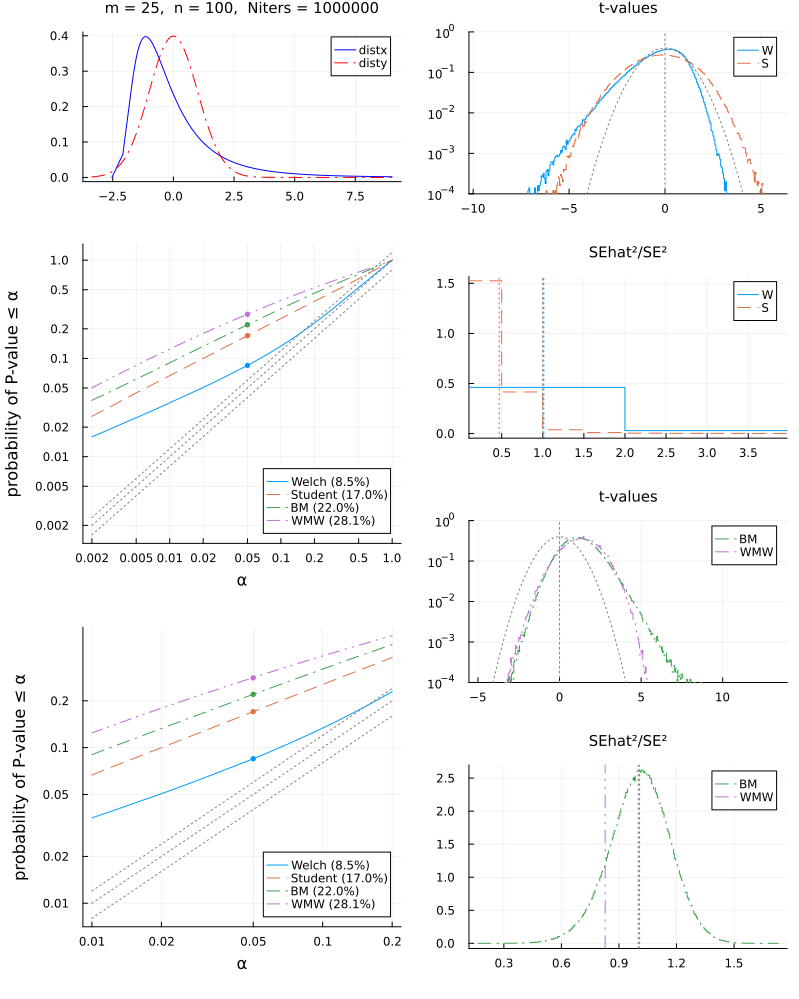

In [14]:
plot_sim(; shifttype=:mean)


  2.633860 seconds (35.82 M allocations: 1.426 GiB, 9.20% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         0.0         0.0

true α-error rate for α = 0.05
  Welch t-test:        0.07254
  Student t-test:      0.279795
  Brunner-Munzel test: 0.05159
  WMW test:            0.06748



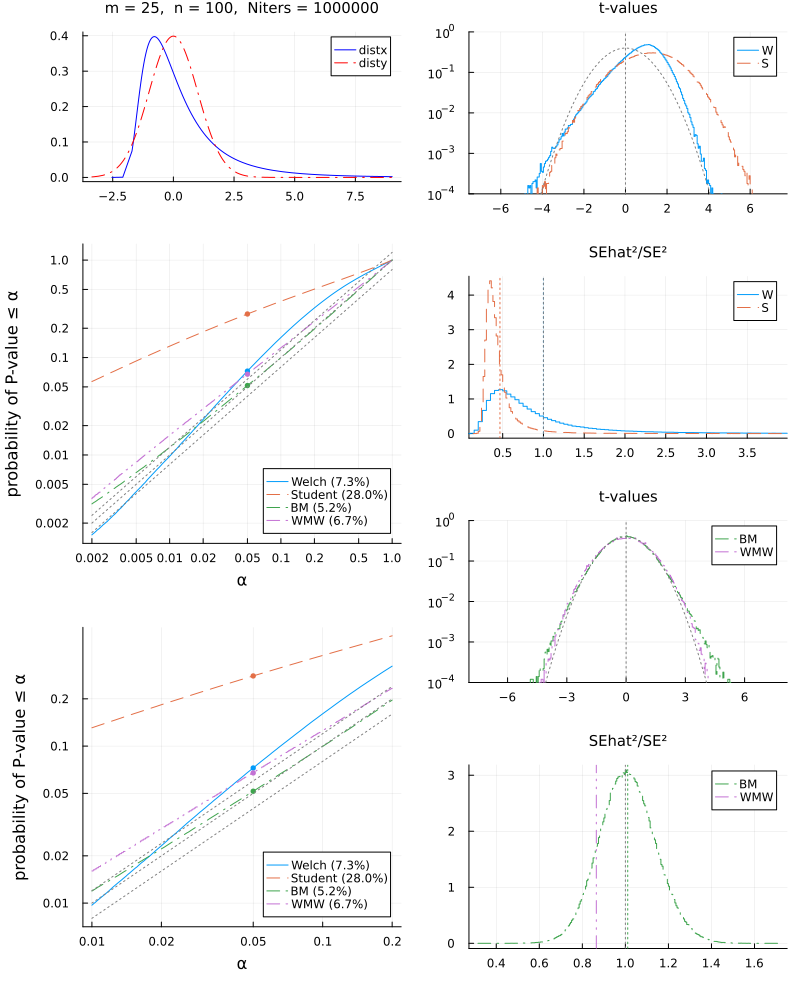

In [15]:
plot_sim(; shifttype=:tie)


  2.451376 seconds (36.59 M allocations: 1.645 GiB, 0.89% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         0.0         0.0

true α-error rate for α = 0.05
  Welch t-test:        0.164214
  Student t-test:      0.443041
  Brunner-Munzel test: 0.086447
  WMW test:            0.107504



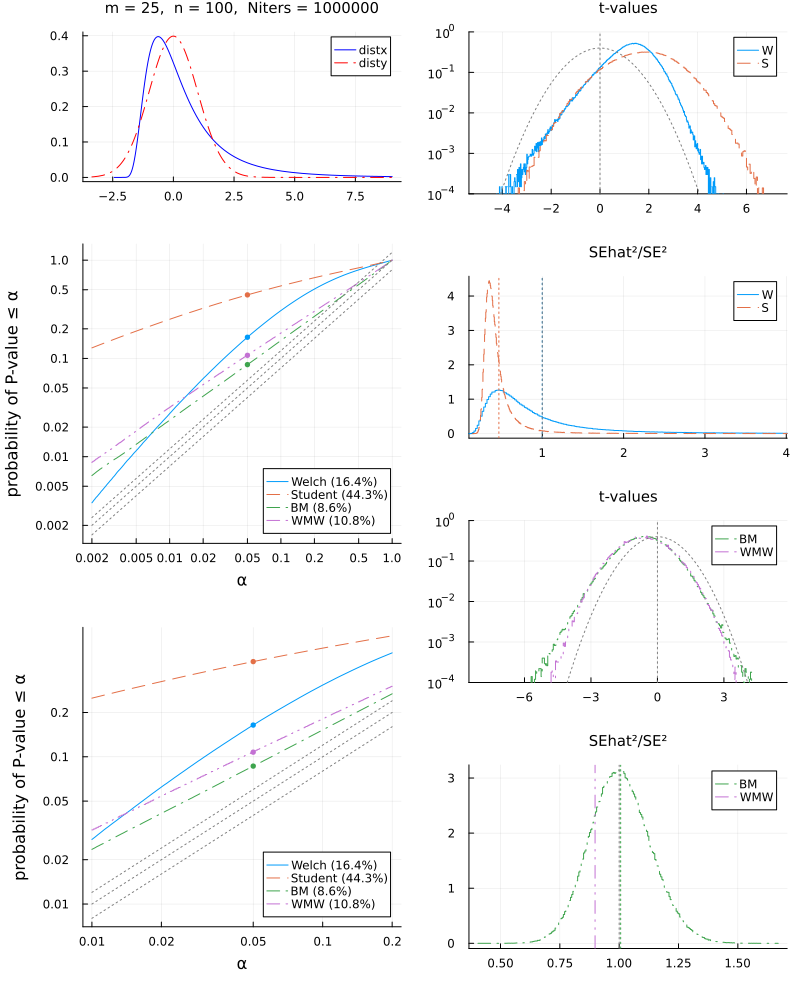

In [16]:
plot_sim(; shifttype=:median)


  3.050434 seconds (41.00 M allocations: 1.335 GiB, 18.05% compilation time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.065267
  Student t-test:      0.048106
  Brunner-Munzel test: 0.051709
  WMW test:            0.048983



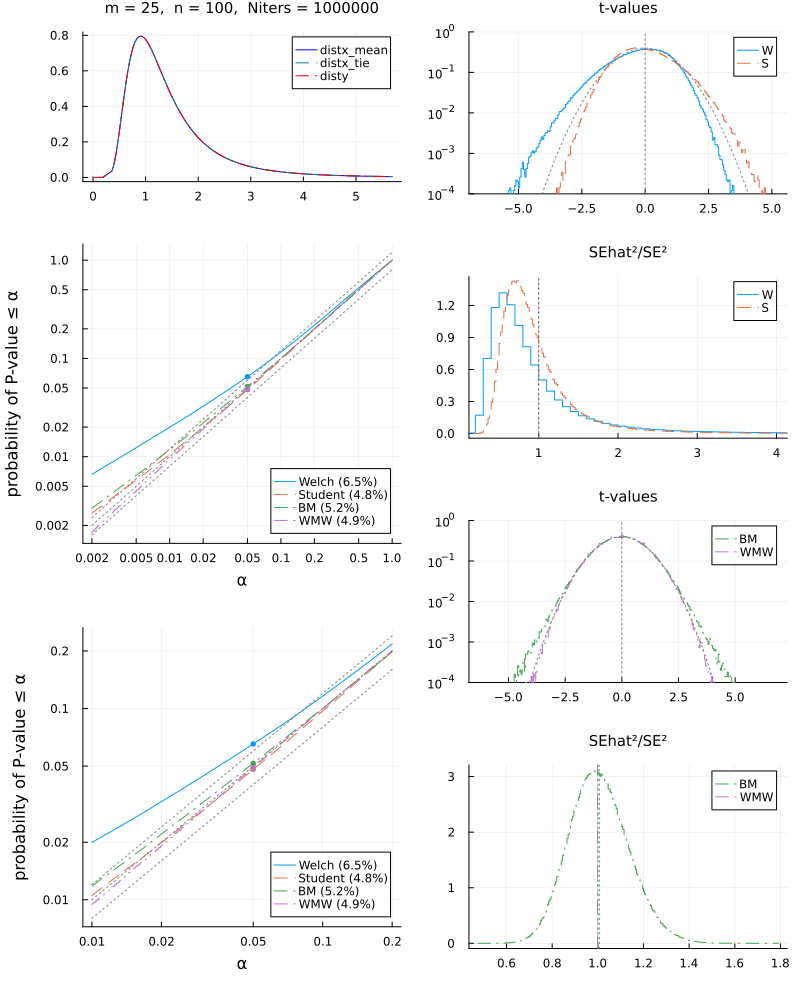

In [17]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=25, n=100)


  2.818662 seconds (4.09 M allocations: 136.402 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.05787
  Student t-test:      0.05008
  Brunner-Munzel test: 0.05117
  WMW test:            0.05075



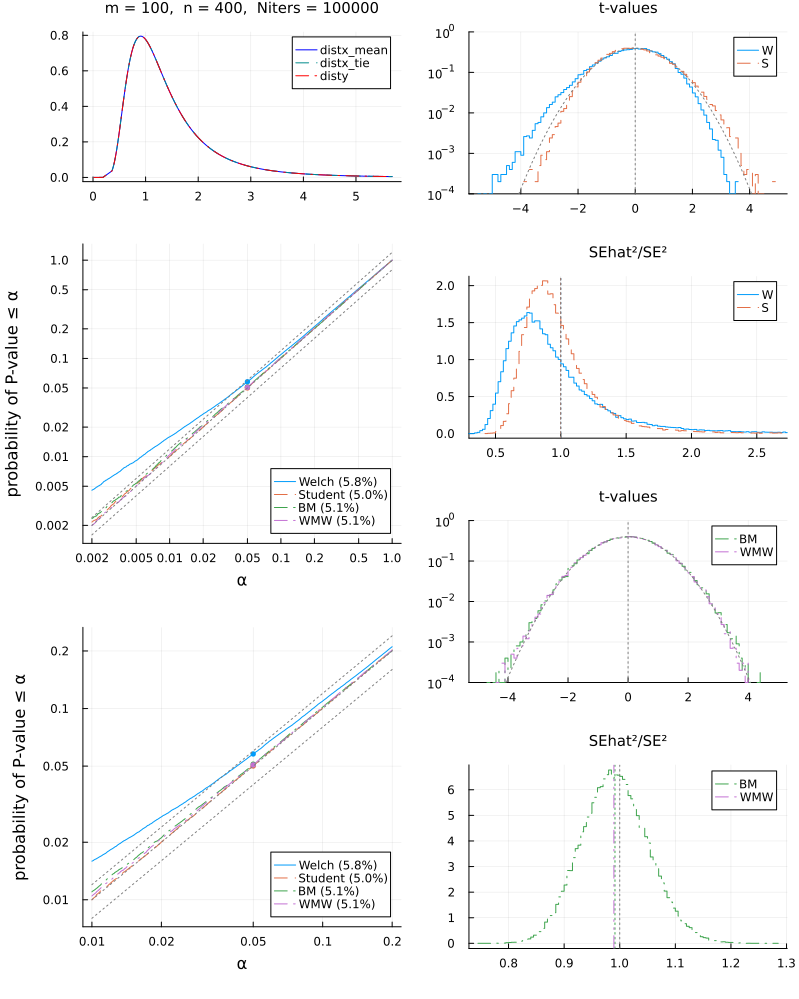

In [18]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=100, n=400, L=10^5)


 39.174072 seconds (4.09 M allocations: 135.715 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.05253
  Student t-test:      0.04903
  Brunner-Munzel test: 0.05036
  WMW test:            0.05028



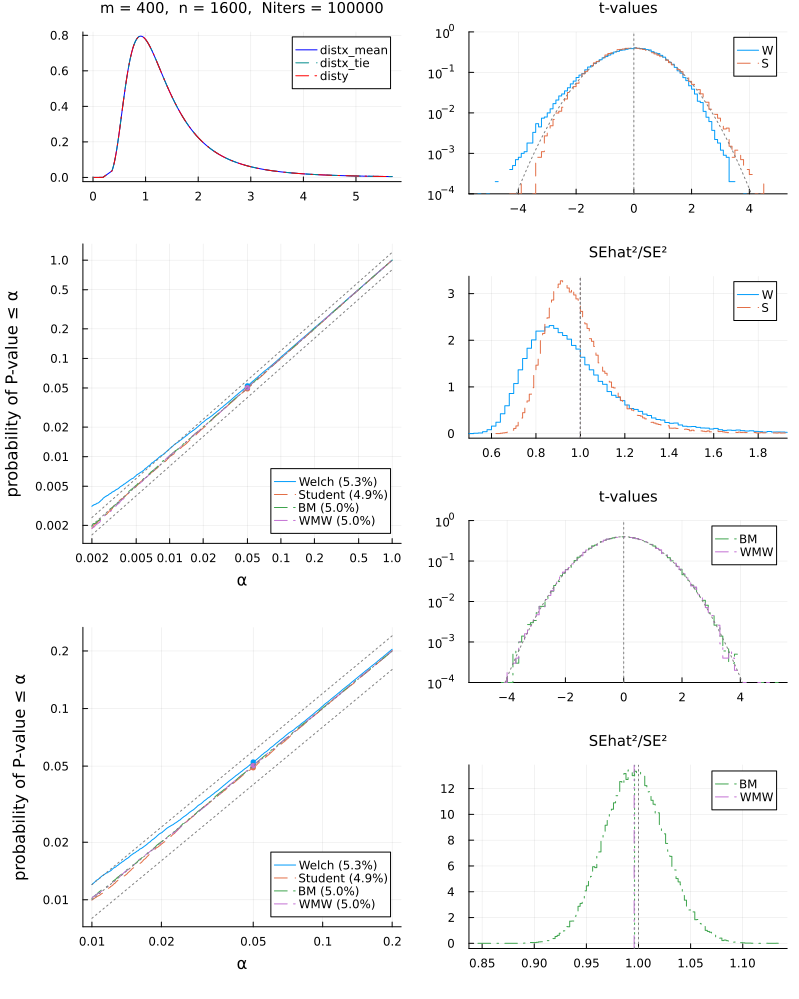

In [19]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=400, n=1600, L=10^5)


  3.125061 seconds (41.08 M allocations: 1.364 GiB, 3.84% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.2         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.071206
  Student t-test:      0.073353
  Brunner-Munzel test: 0.051765
  WMW test:            0.062775



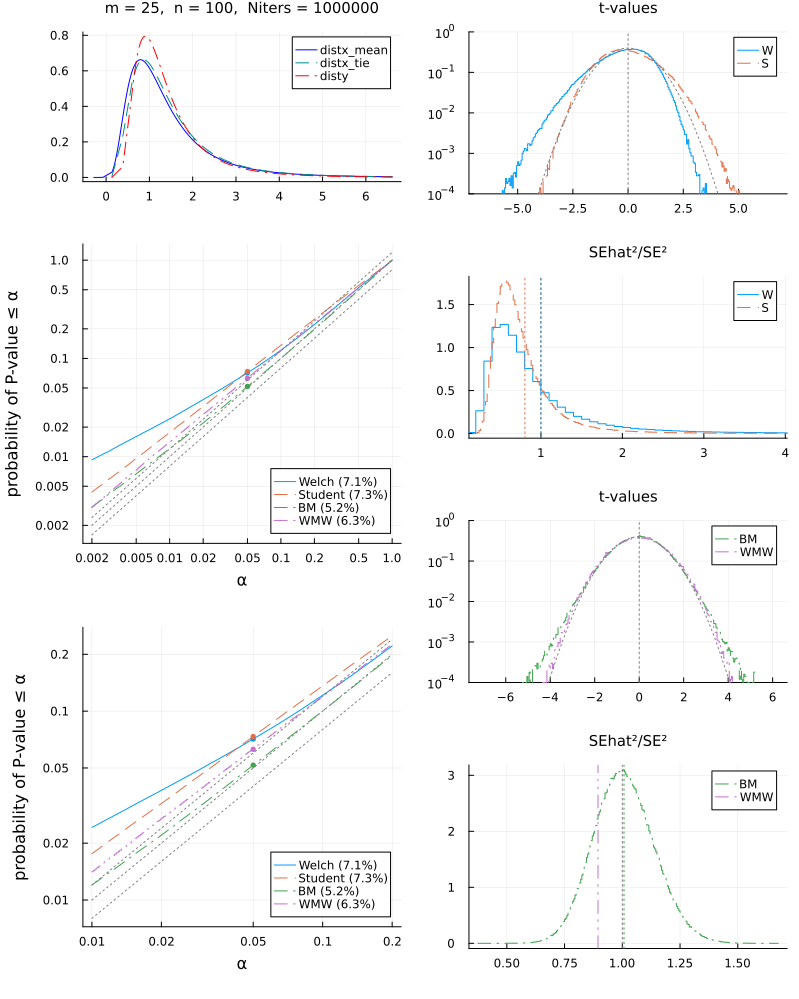

In [20]:
distx = inversegammadist(1.2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=25, n=100)


  2.813823 seconds (4.10 M allocations: 139.076 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.2         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.05855
  Student t-test:      0.07682
  Brunner-Munzel test: 0.05054
  WMW test:            0.06405



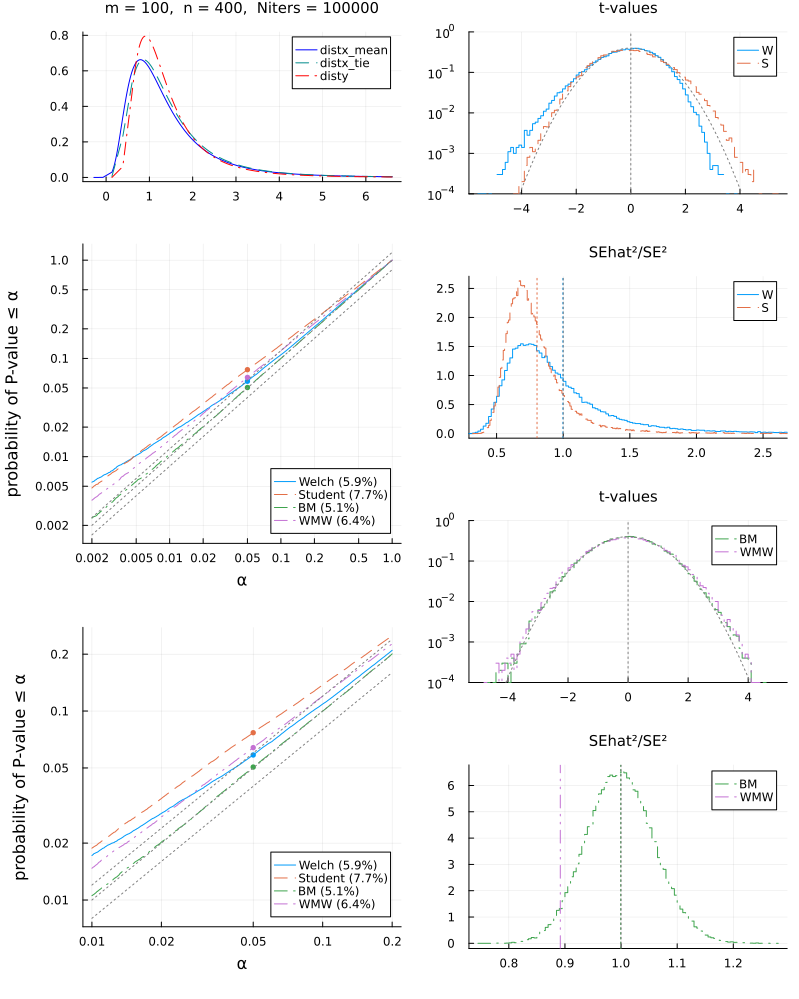

In [21]:
distx = inversegammadist(1.2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=100, n=400, L=10^5)


 39.264960 seconds (4.10 M allocations: 138.557 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.2         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.05475
  Student t-test:      0.07876
  Brunner-Munzel test: 0.05034
  WMW test:            0.06467



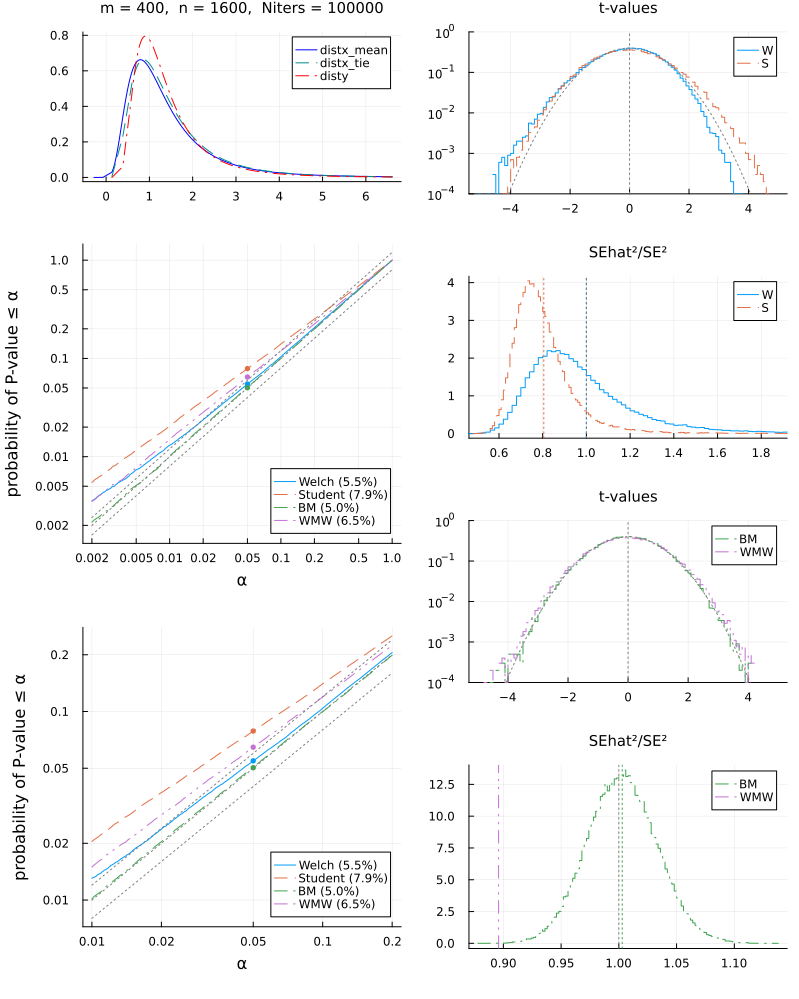

In [22]:
distx = inversegammadist(1.2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=400, n=1600, L=10^5)


  3.236400 seconds (41.33 M allocations: 1.438 GiB, 5.26% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.084401
  Student t-test:      0.181257
  Brunner-Munzel test: 0.051658
  WMW test:            0.103908



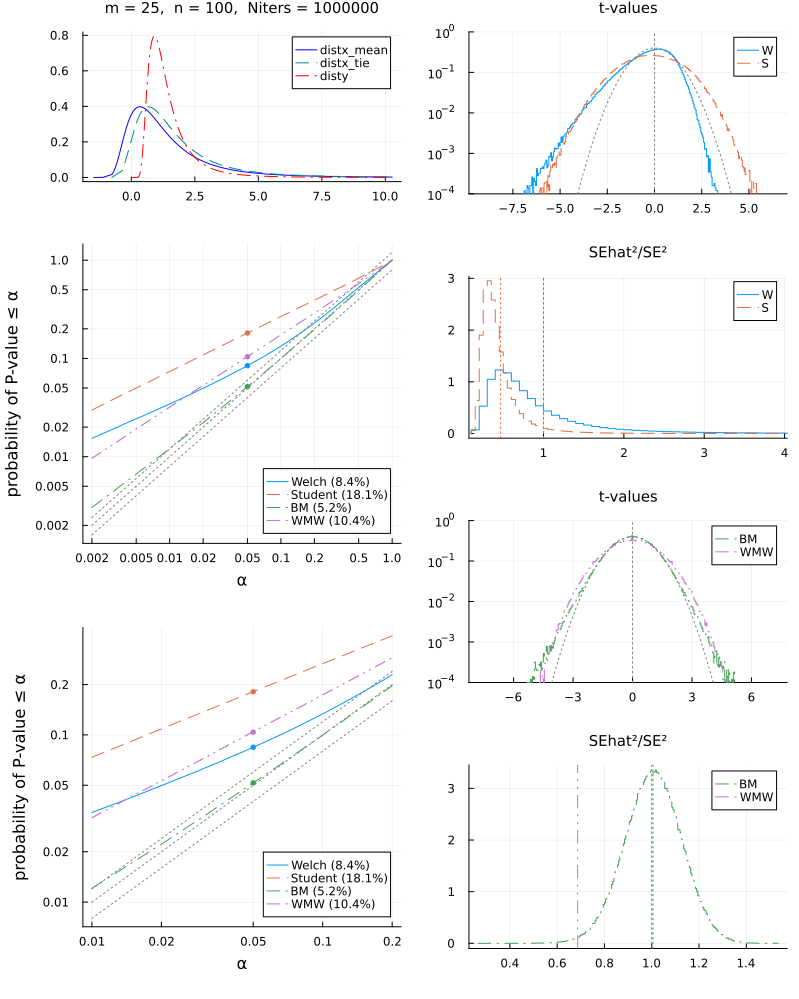

In [23]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=25, n=100)


  3.313646 seconds (40.84 M allocations: 1.299 GiB, 2.87% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         5.0       277.0
 disty     1.2         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.057896
  Student t-test:      0.031602
  Brunner-Munzel test: 0.051363
  WMW test:            0.036725



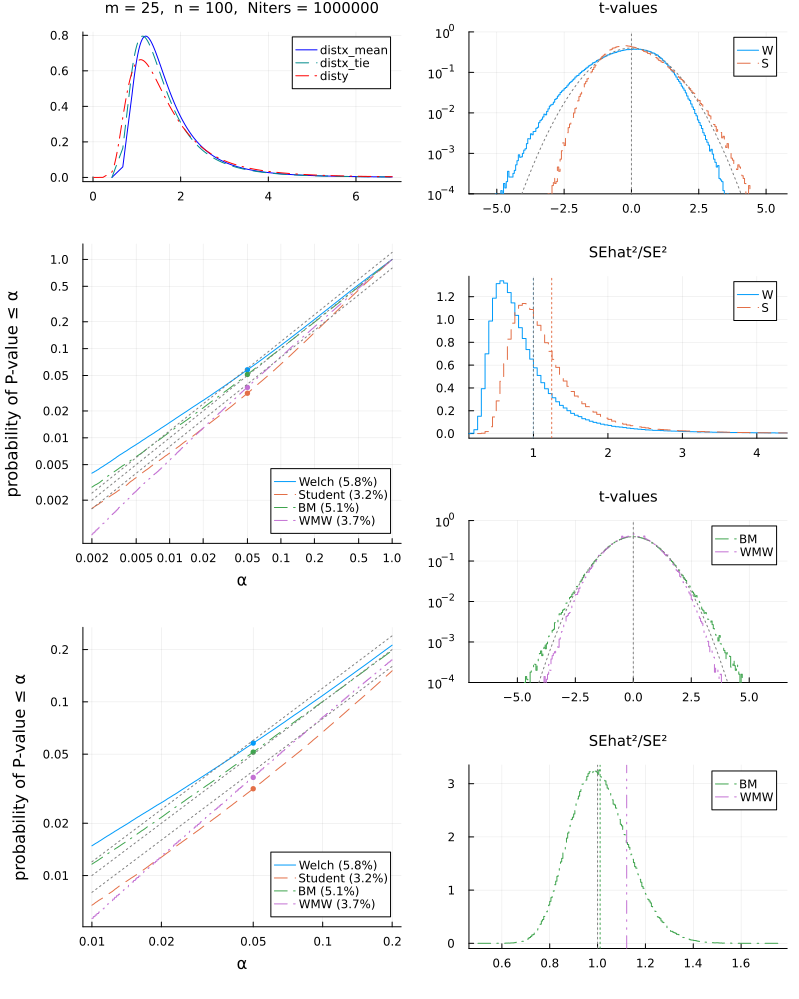

In [24]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1.2, 5)
plot_sim(; distx, disty, m=25, n=100)


  3.568633 seconds (40.73 M allocations: 1.265 GiB, 4.03% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         5.0       277.0
 disty     1.5         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.050681
  Student t-test:      0.020555
  Brunner-Munzel test: 0.051652
  WMW test:            0.02599



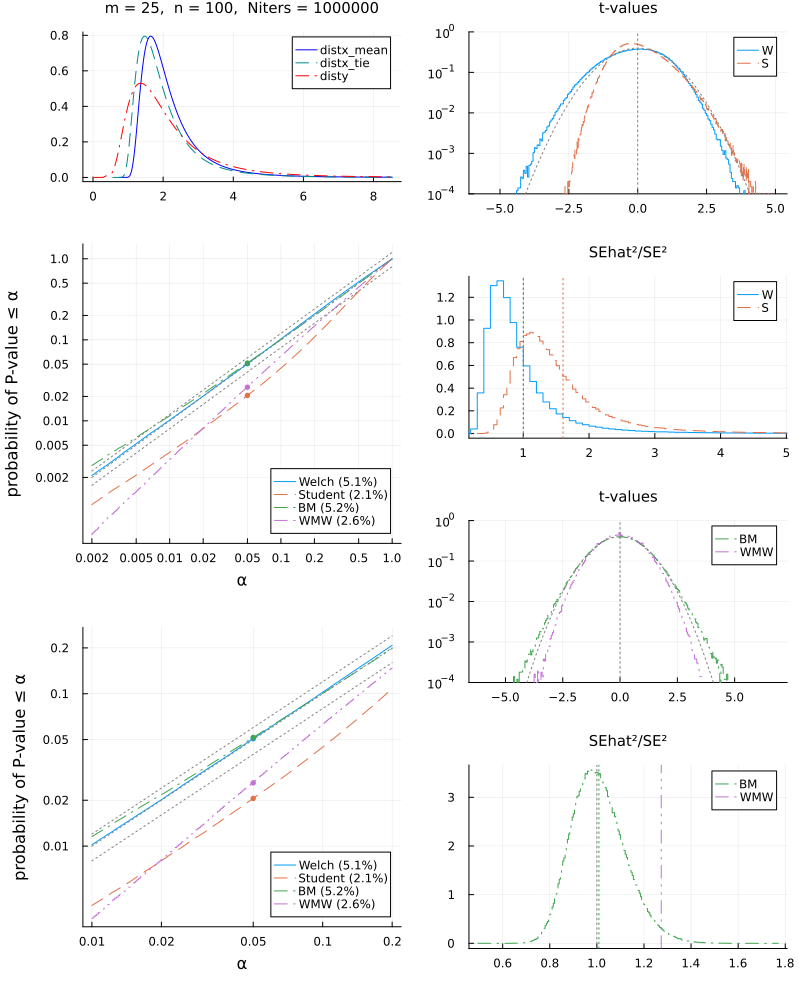

In [25]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1.5, 5)
plot_sim(; distx, disty, m=25, n=100)


  2.943160 seconds (37.87 M allocations: 2.007 GiB, 2.04% gc time, 2.65% compilation time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         5.0       277.0
 disty     1.5         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.823493
  Student t-test:      0.744124
  Brunner-Munzel test: 0.906131
  WMW test:            0.92361



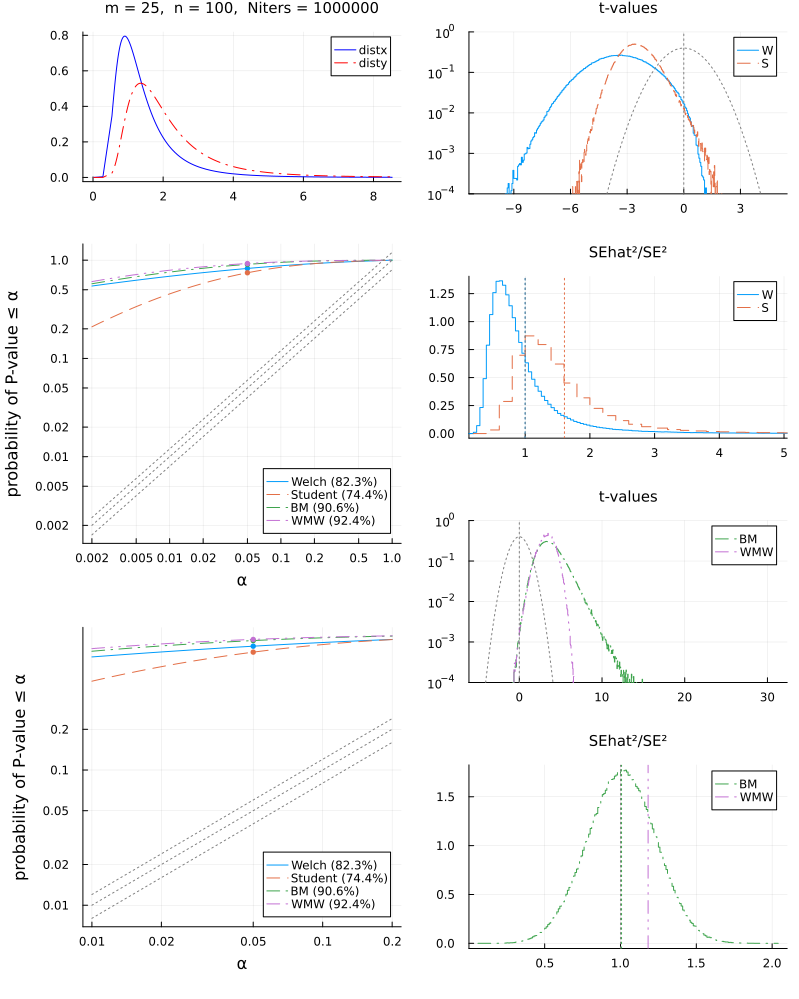

In [26]:
distx = inversegammadist(1, 5)
disty = inversegammadist(1.5, 5)
plot_sim(; distx, disty, m=25, n=100, shifttype=:none)


  3.168481 seconds (40.99 M allocations: 1.328 GiB, 6.19% gc time, 32.76% compilation time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         1.5         3.4
 disty     1.0         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.057049
  Student t-test:      0.048982
  Brunner-Munzel test: 0.051625
  WMW test:            0.048817



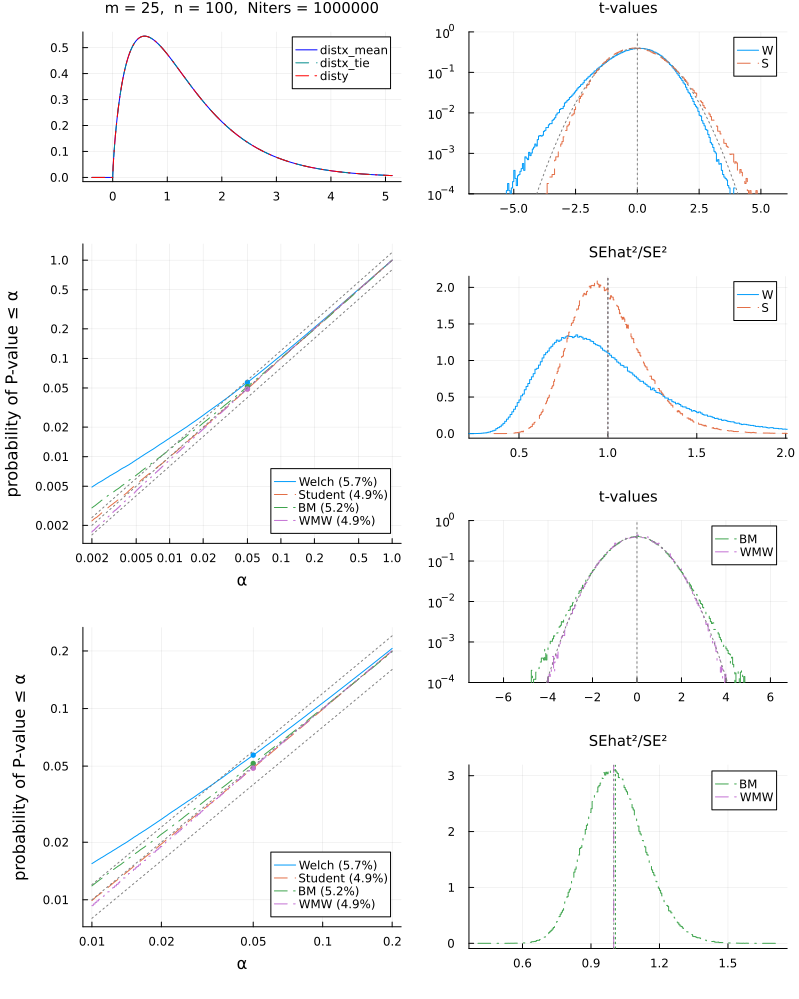

In [27]:
distx = gammadist(1, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  3.070642 seconds (41.04 M allocations: 1.354 GiB, 7.76% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.2         1.5         3.4
 disty     1.0         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.05903
  Student t-test:      0.077583
  Brunner-Munzel test: 0.051768
  WMW test:            0.064639



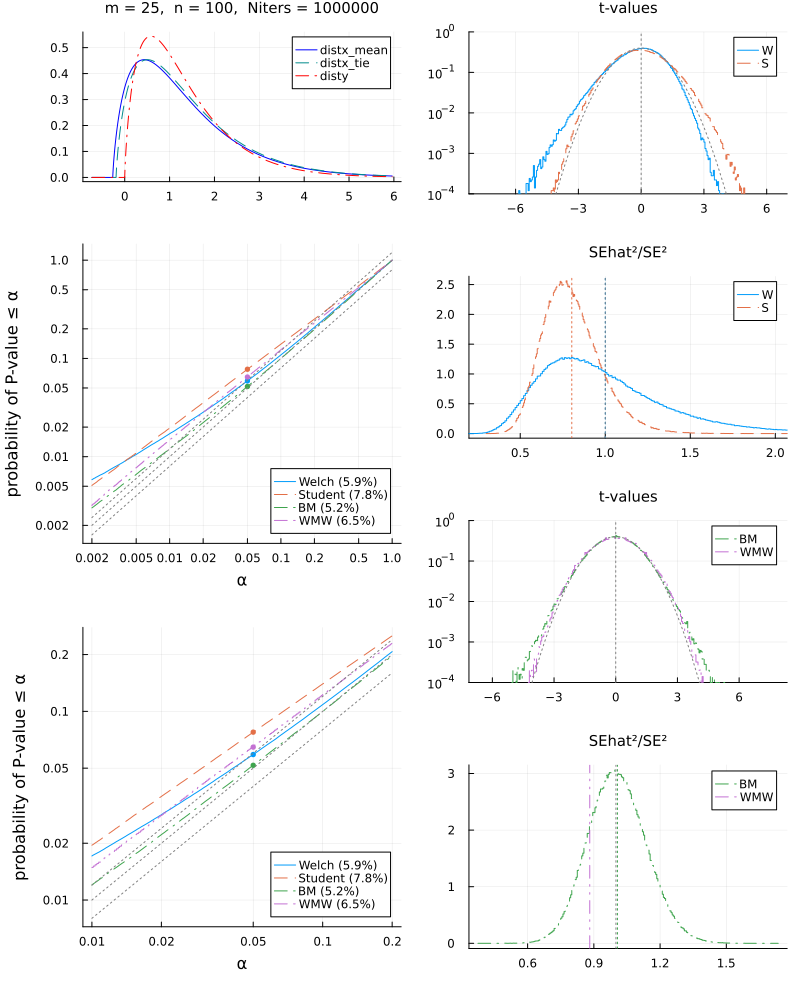

In [28]:
distx = gammadist(1.2, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  2.893480 seconds (41.16 M allocations: 1.388 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.5         1.5         3.4
 disty     1.0         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.061727
  Student t-test:      0.121607
  Brunner-Munzel test: 0.051725
  WMW test:            0.085176



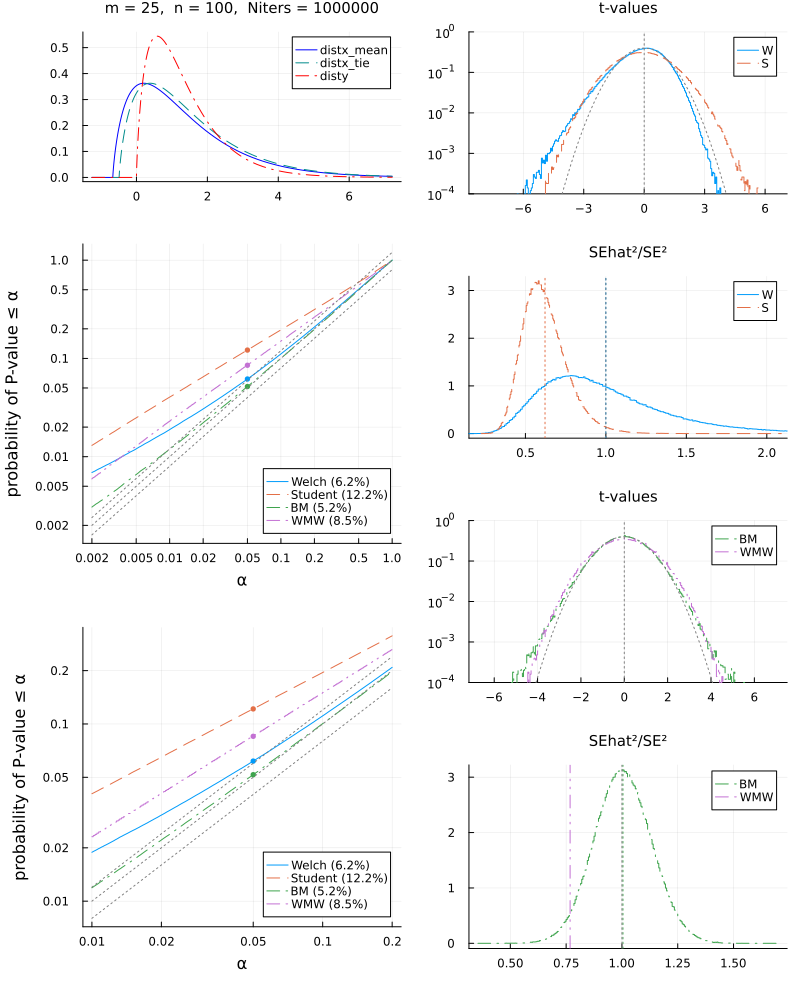

In [29]:
distx = gammadist(1.5, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  2.819893 seconds (40.83 M allocations: 1.294 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         1.5         3.4
 disty     1.2         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.054872
  Student t-test:      0.029705
  Brunner-Munzel test: 0.052055
  WMW test:            0.03589



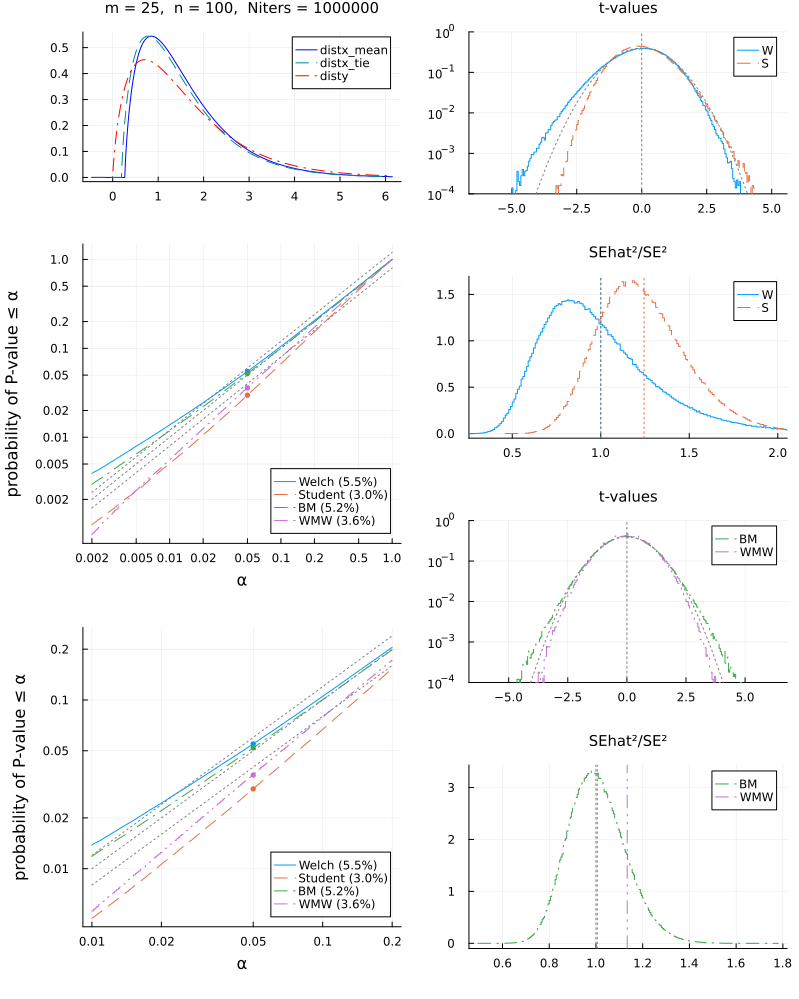

In [30]:
distx = gammadist(1, 1.5)
disty = gammadist(1.2, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  2.815943 seconds (40.70 M allocations: 1.259 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         1.5         3.4
 disty     1.5         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.051953
  Student t-test:      0.015185
  Brunner-Munzel test: 0.051588
  WMW test:            0.02408



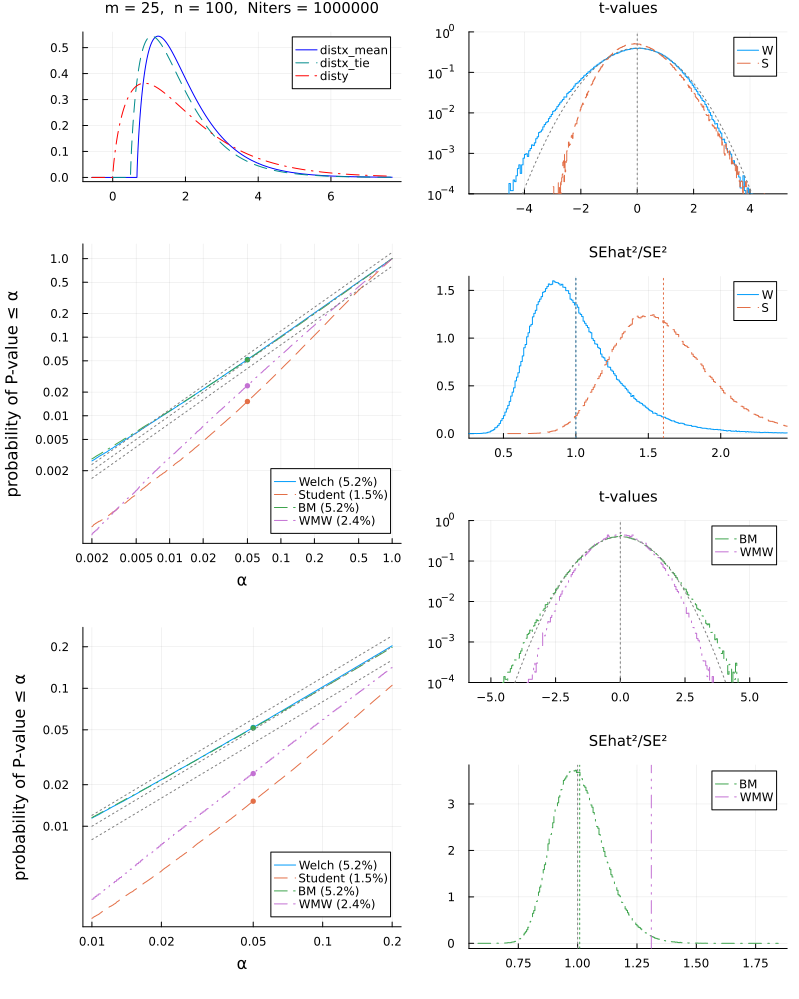

In [31]:
distx = gammadist(1, 1.5)
disty = gammadist(1.5, 1.5)
plot_sim(; distx, disty, m=25, n=100)


  2.687644 seconds (38.40 M allocations: 2.156 GiB, 2.44% compilation time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         1.5         3.4
 disty     1.5         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.732036
  Student t-test:      0.583699
  Brunner-Munzel test: 0.616238
  WMW test:            0.583327



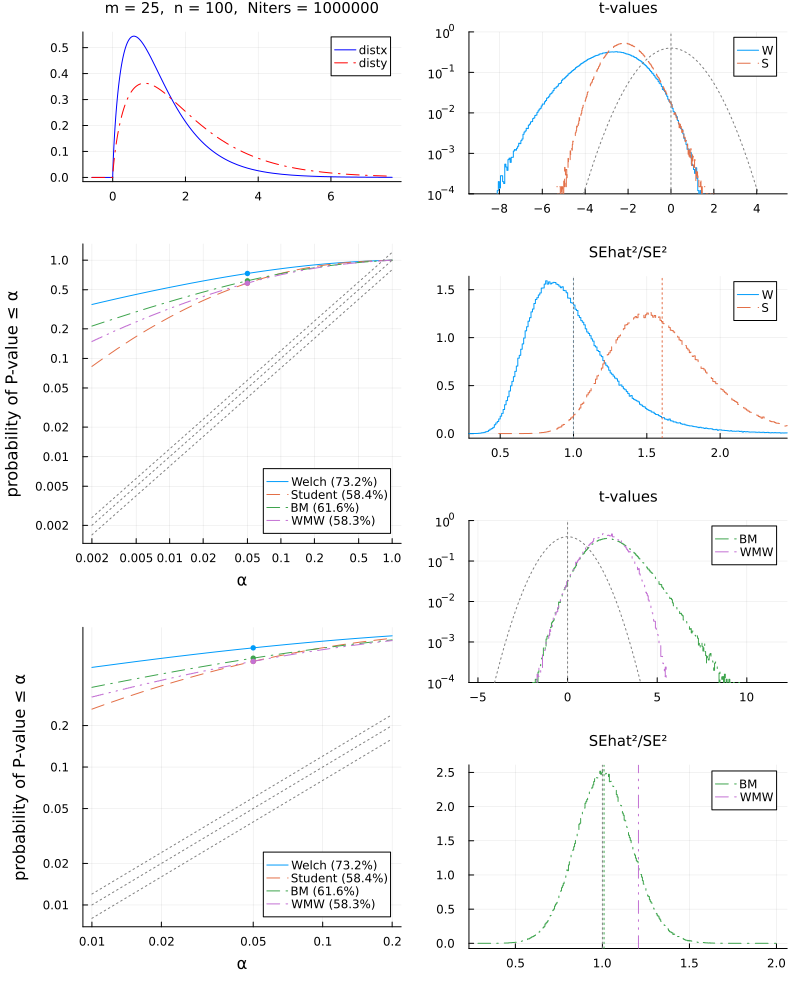

In [32]:
distx = gammadist(1, 1.5)
disty = gammadist(1.5, 1.5)
plot_sim(; distx, disty, m=25, n=100, shifttype=:none)


  7.998858 seconds (40.97 M allocations: 1.334 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.055467
  Student t-test:      0.055885
  Brunner-Munzel test: 0.050621
  WMW test:            0.058195



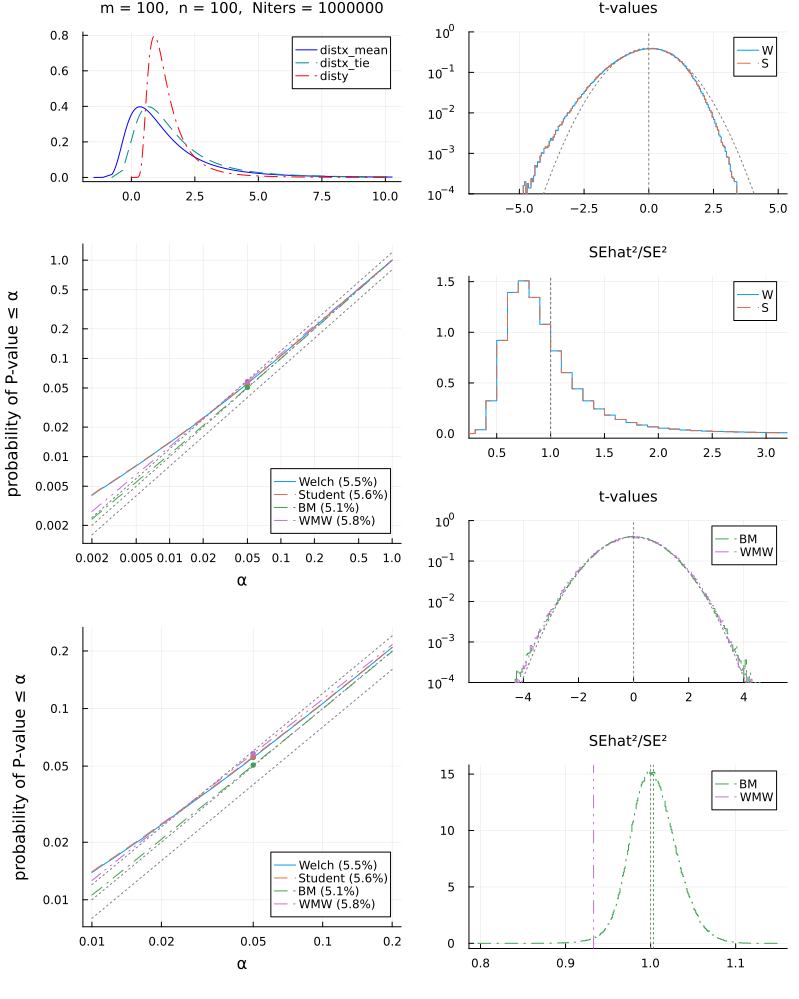

In [33]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=100, n=100)


  7.217481 seconds (41.00 M allocations: 1.343 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.057015
  Student t-test:      0.063509
  Brunner-Munzel test: 0.05057
  WMW test:            0.06214



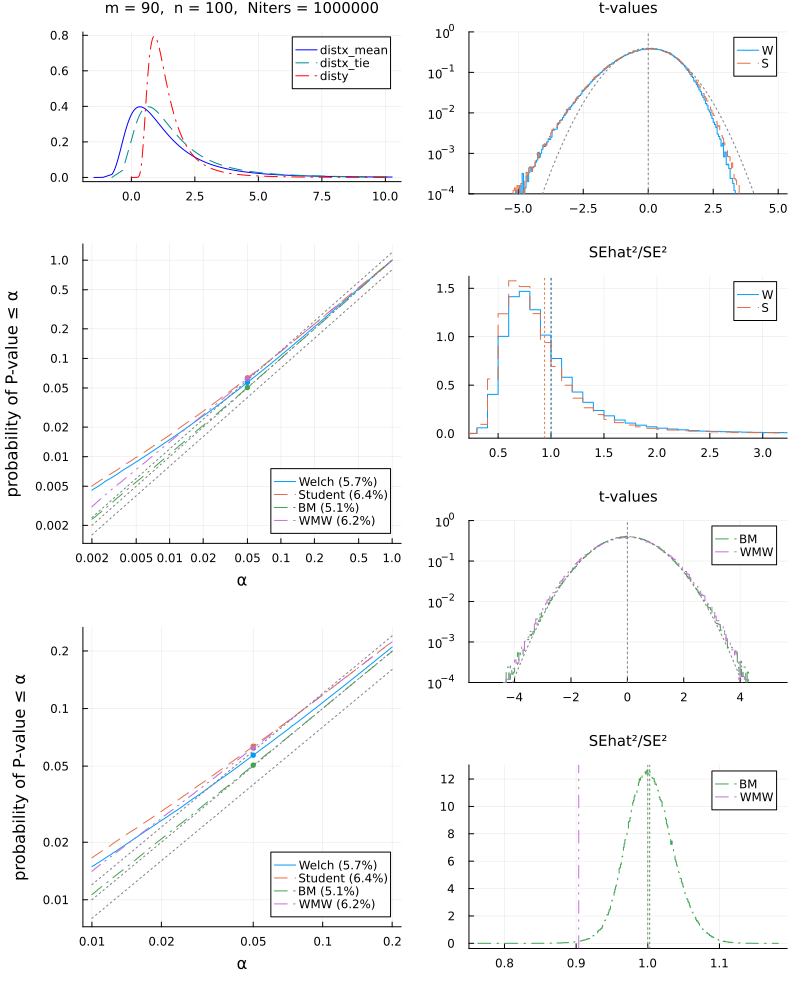

In [34]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=90, n=100)


  7.254230 seconds (41.02 M allocations: 1.348 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     3.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.063391
  Student t-test:      0.073223
  Brunner-Munzel test: 0.050697
  WMW test:            0.073224



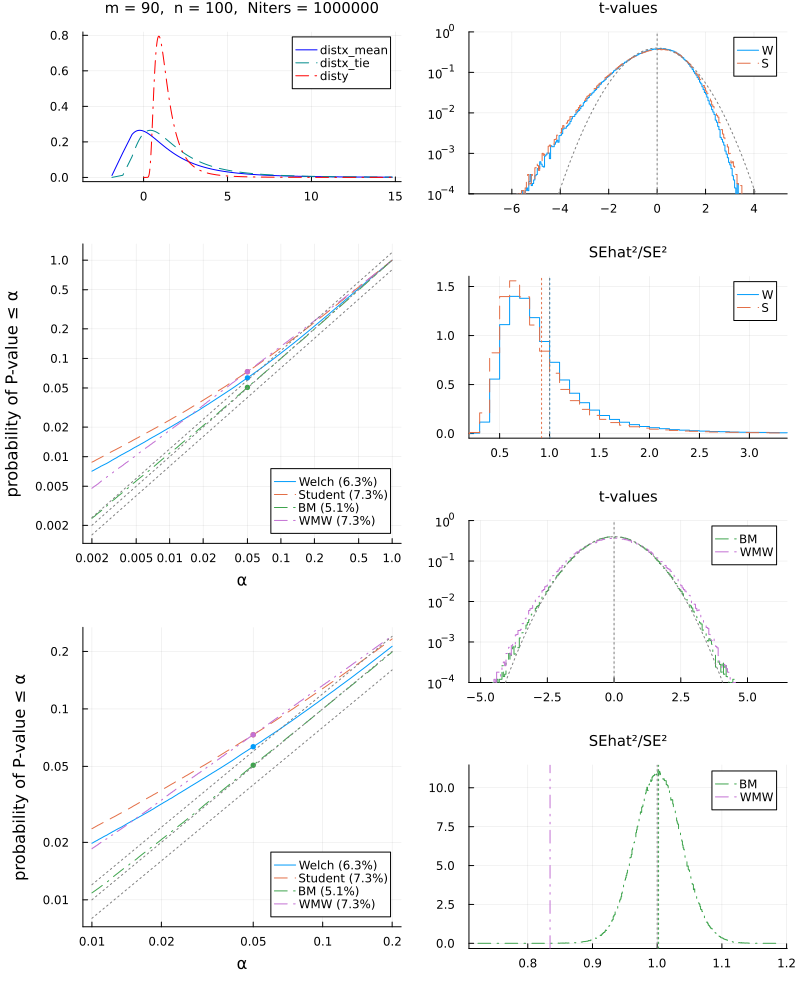

In [35]:
distx = inversegammadist(3, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=90, n=100)


  8.942226 seconds (4.09 M allocations: 137.392 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     3.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.0554
  Student t-test:      0.06518
  Brunner-Munzel test: 0.05134
  WMW test:            0.07497



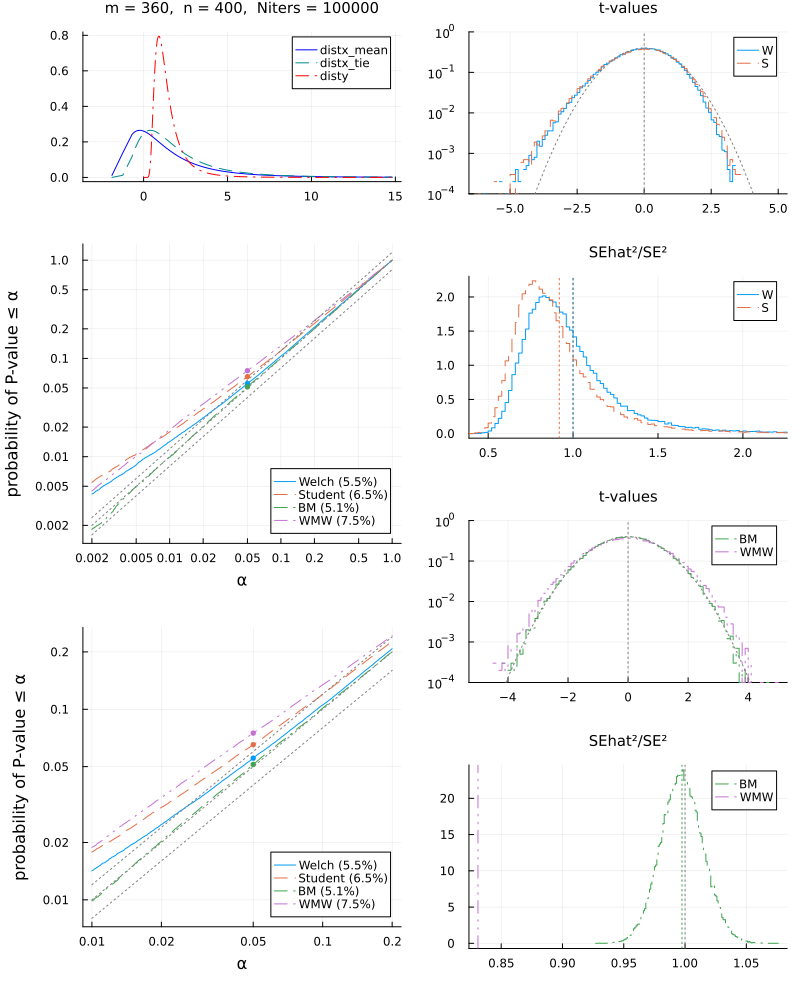

In [36]:
distx = inversegammadist(3, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=360, n=400, L=10^5)


  6.869120 seconds (41.04 M allocations: 1.354 GiB, 2.18% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.059372
  Student t-test:      0.073117
  Brunner-Munzel test: 0.050923
  WMW test:            0.066698



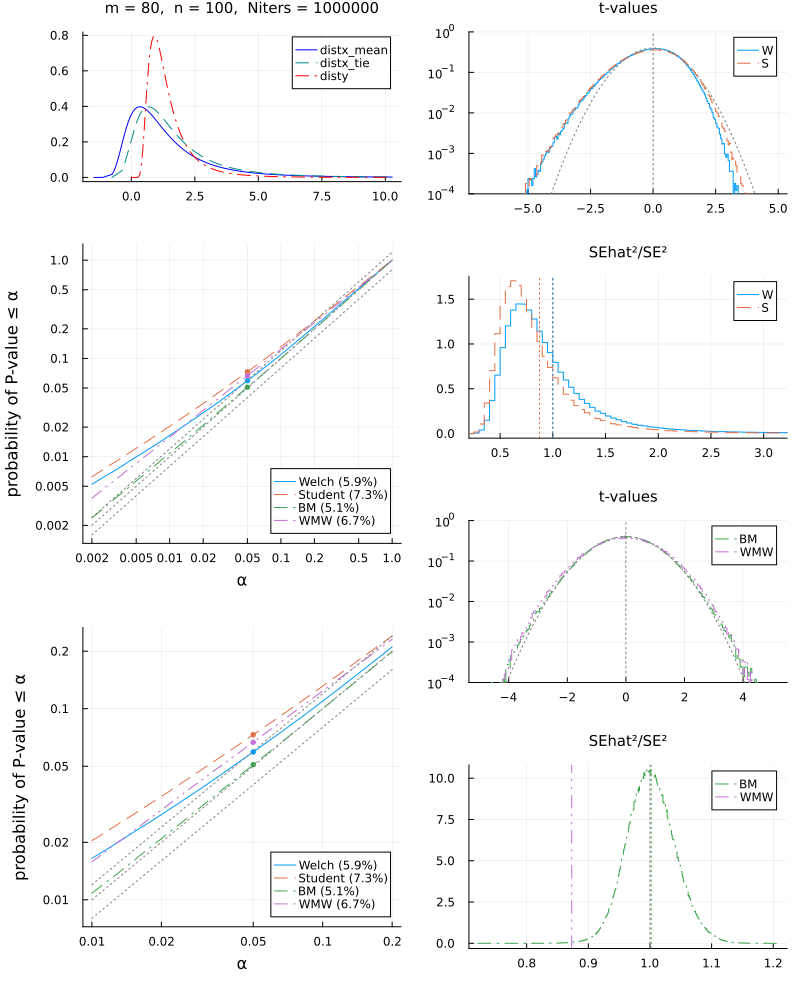

In [37]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=80, n=100)


  8.057298 seconds (4.10 M allocations: 137.696 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.05374
  Student t-test:      0.06932
  Brunner-Munzel test: 0.04965
  WMW test:            0.06631



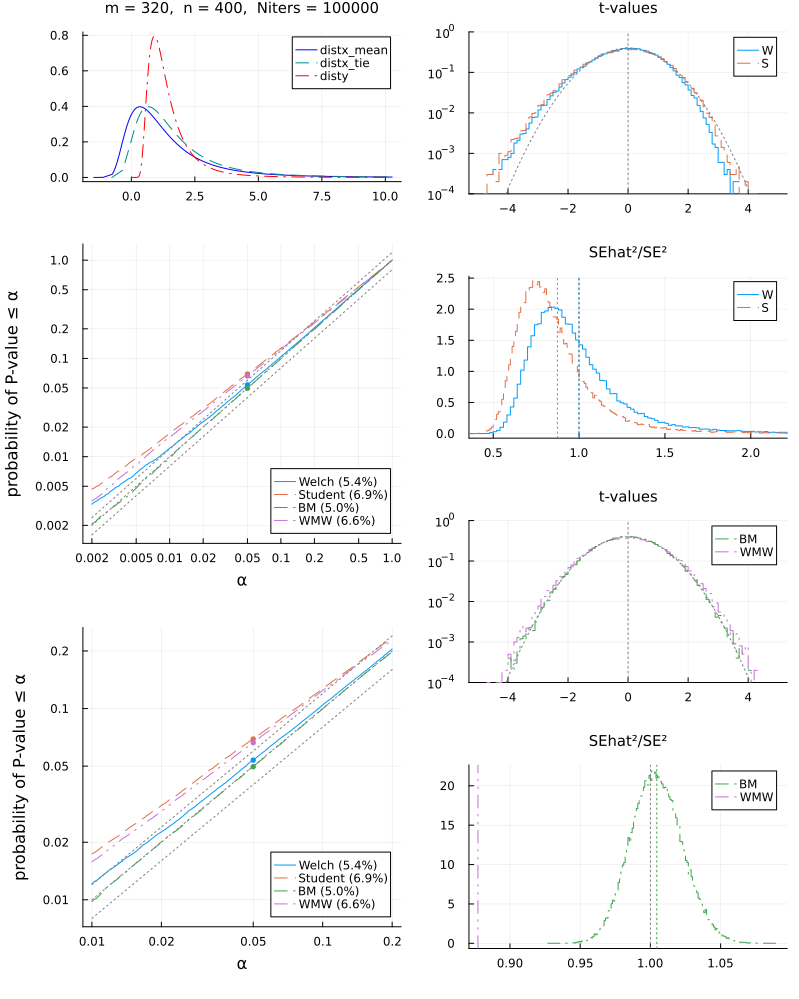

In [38]:
distx = inversegammadist(2, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)


  6.788494 seconds (41.07 M allocations: 1.364 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     3.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.065384
  Student t-test:      0.086696
  Brunner-Munzel test: 0.050278
  WMW test:            0.079288



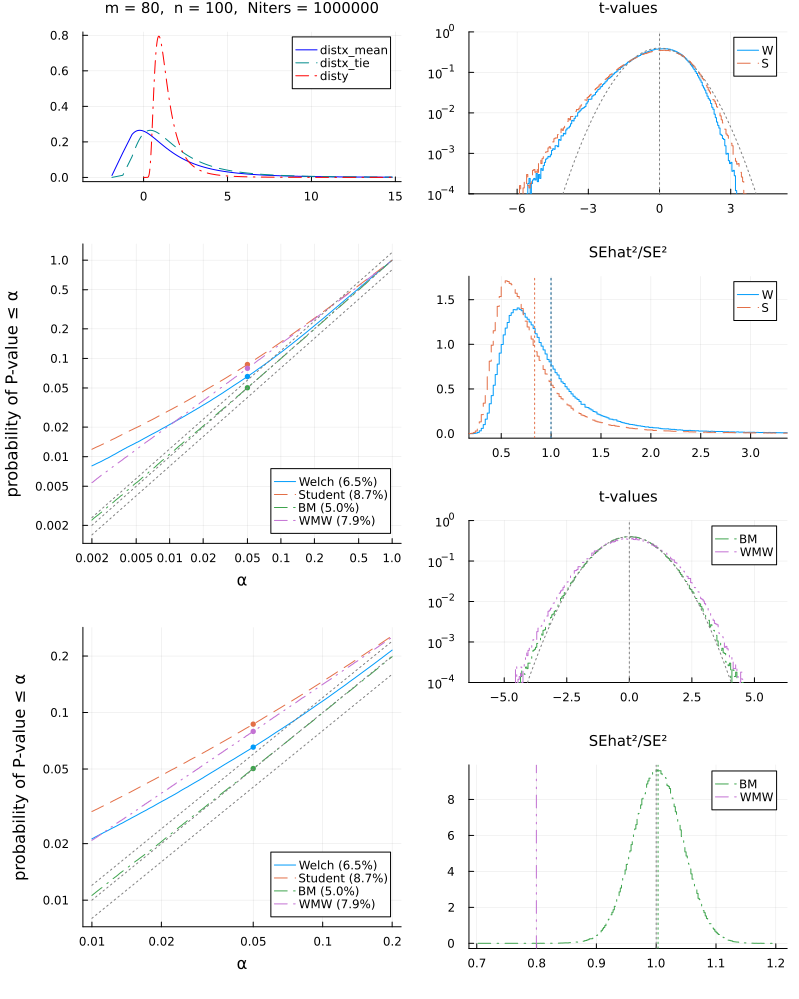

In [39]:
distx = inversegammadist(3, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=80, n=100)


  8.528830 seconds (4.10 M allocations: 138.292 MiB, 0.37% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     3.0         5.0       277.0
 disty     1.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.05579
  Student t-test:      0.07868
  Brunner-Munzel test: 0.04892
  WMW test:            0.07886



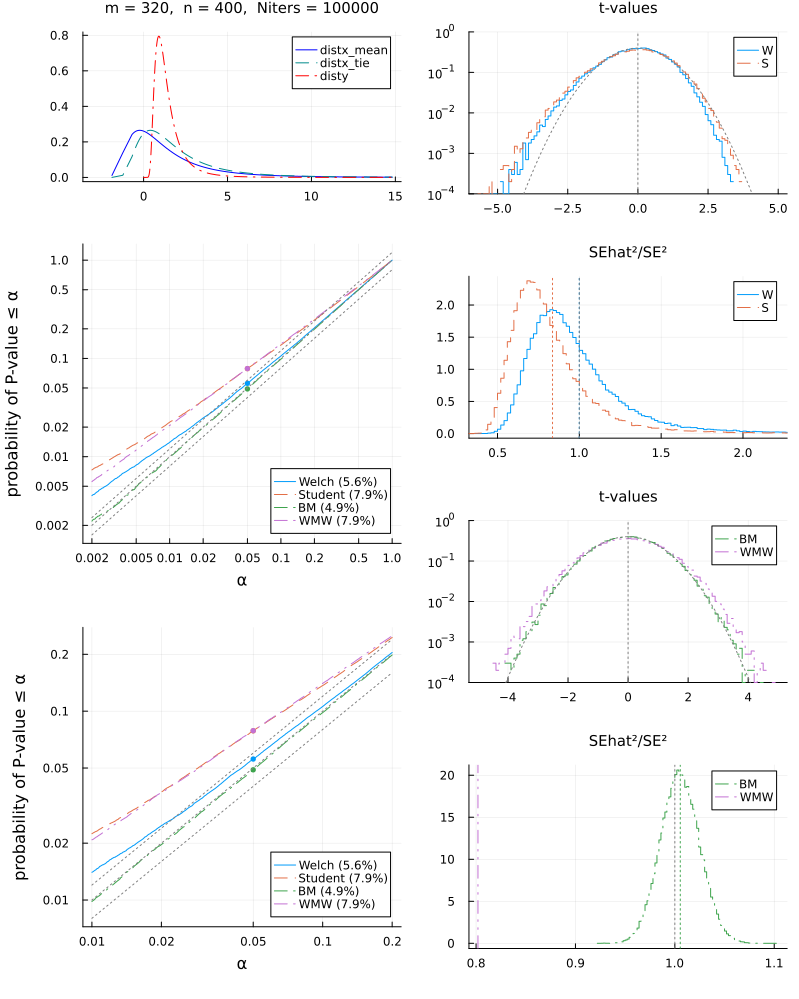

In [40]:
distx = inversegammadist(3, 5)
disty = inversegammadist(1, 5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)


  7.105995 seconds (40.89 M allocations: 1.311 GiB, 2.71% gc time)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         5.0       277.0
 disty     3.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.060022
  Student t-test:      0.044918
  Brunner-Munzel test: 0.050258
  WMW test:            0.055298



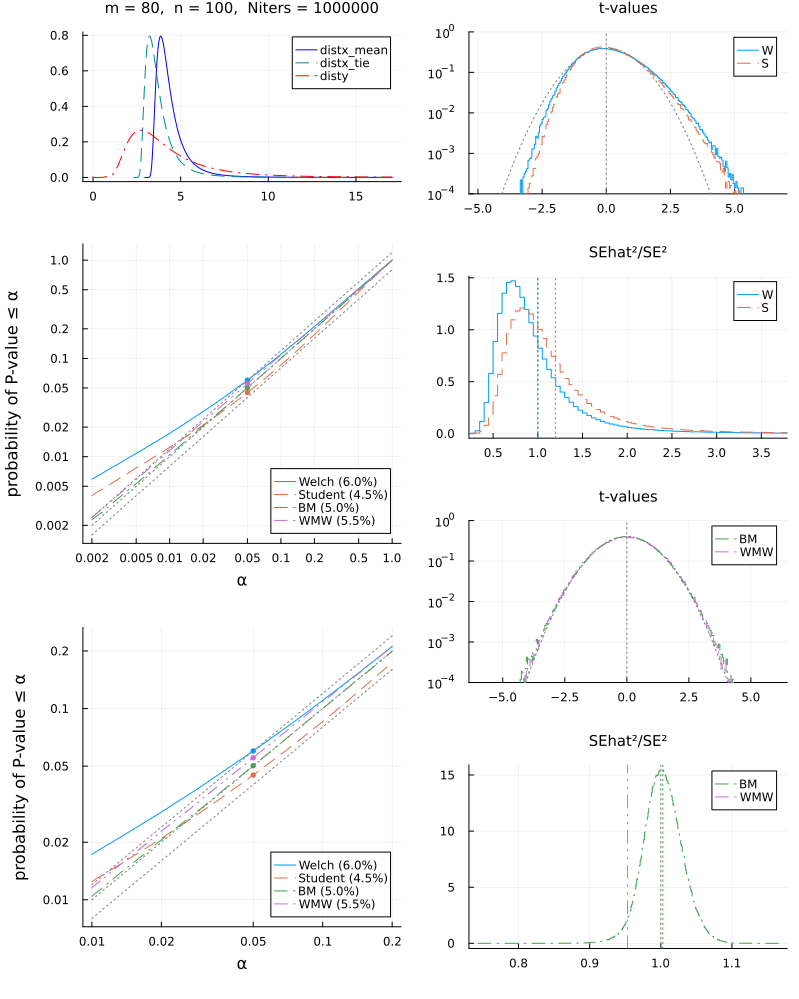

In [41]:
distx = inversegammadist(1, 5)
disty = inversegammadist(3, 5)
plot_sim(; distx, disty, m=80, n=100)


  8.020205 seconds (4.08 M allocations: 133.387 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         5.0       277.0
 disty     3.0         5.0       277.0

true α-error rate for α = 0.05
  Welch t-test:        0.05299
  Student t-test:      0.03628
  Brunner-Munzel test: 0.05016
  WMW test:            0.05526



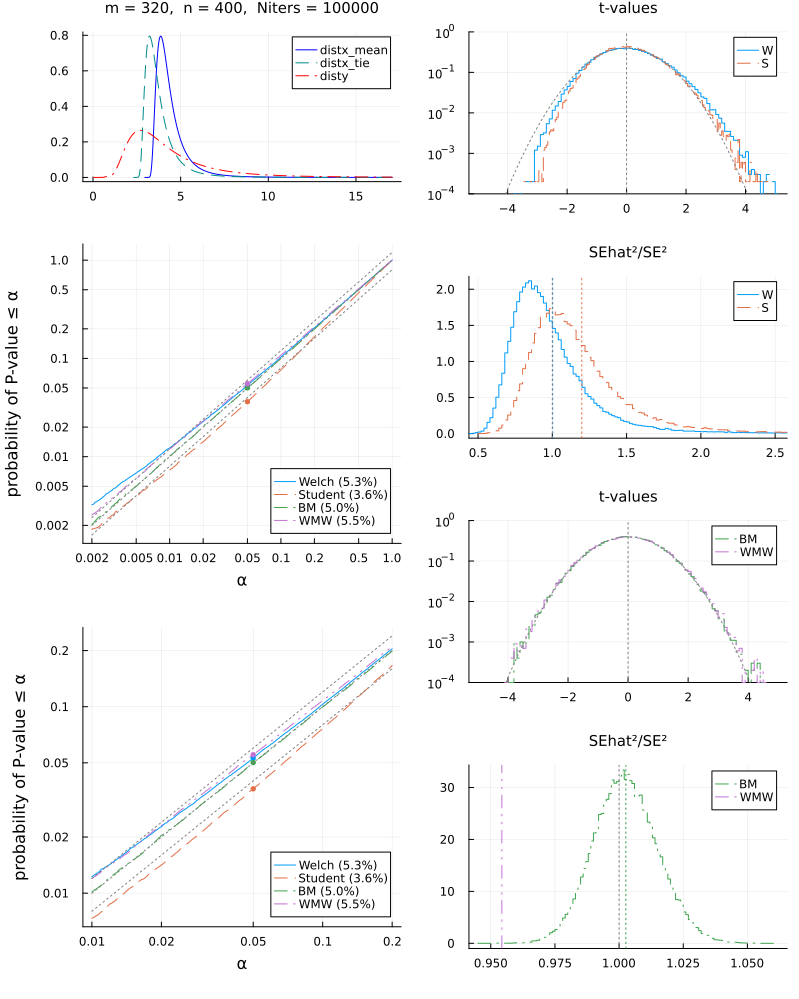

In [42]:
distx = inversegammadist(1, 5)
disty = inversegammadist(3, 5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)


  6.538310 seconds (41.02 M allocations: 1.348 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     3.0         1.5         3.4
 disty     1.0         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.054272
  Student t-test:      0.077782
  Brunner-Munzel test: 0.050284
  WMW test:            0.082322



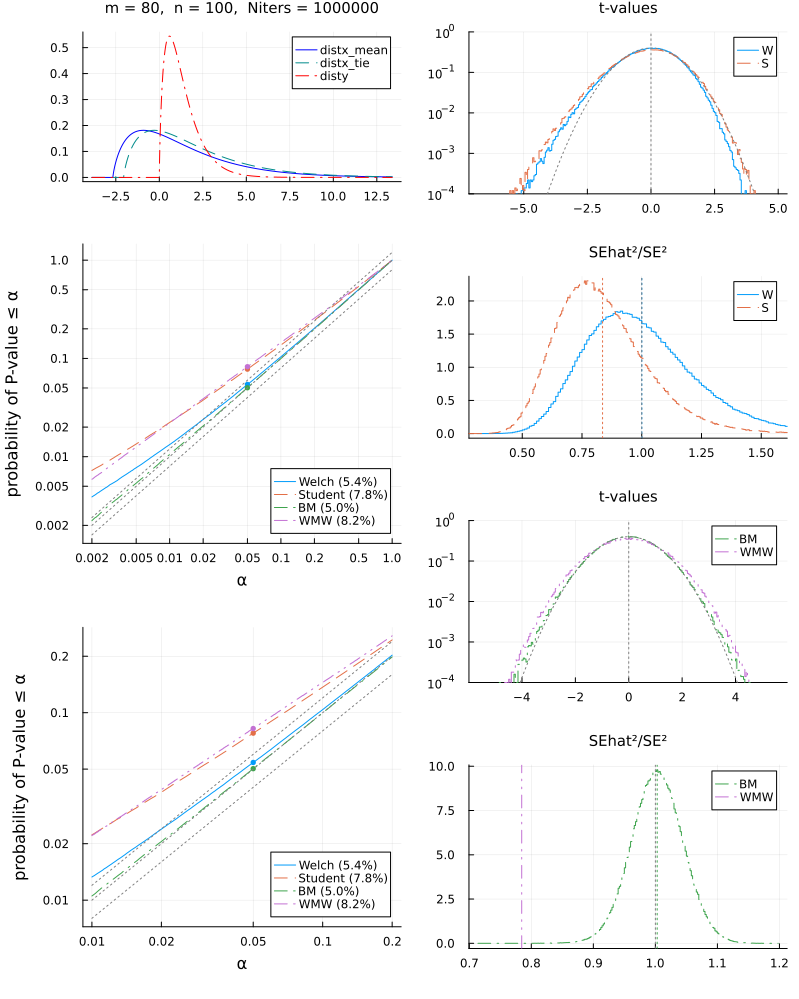

In [43]:
distx = gammadist(3, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=80, n=100)


  7.966152 seconds (4.10 M allocations: 137.836 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     3.0         1.5         3.4
 disty     1.0         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.05015
  Student t-test:      0.07368
  Brunner-Munzel test: 0.04958
  WMW test:            0.08222



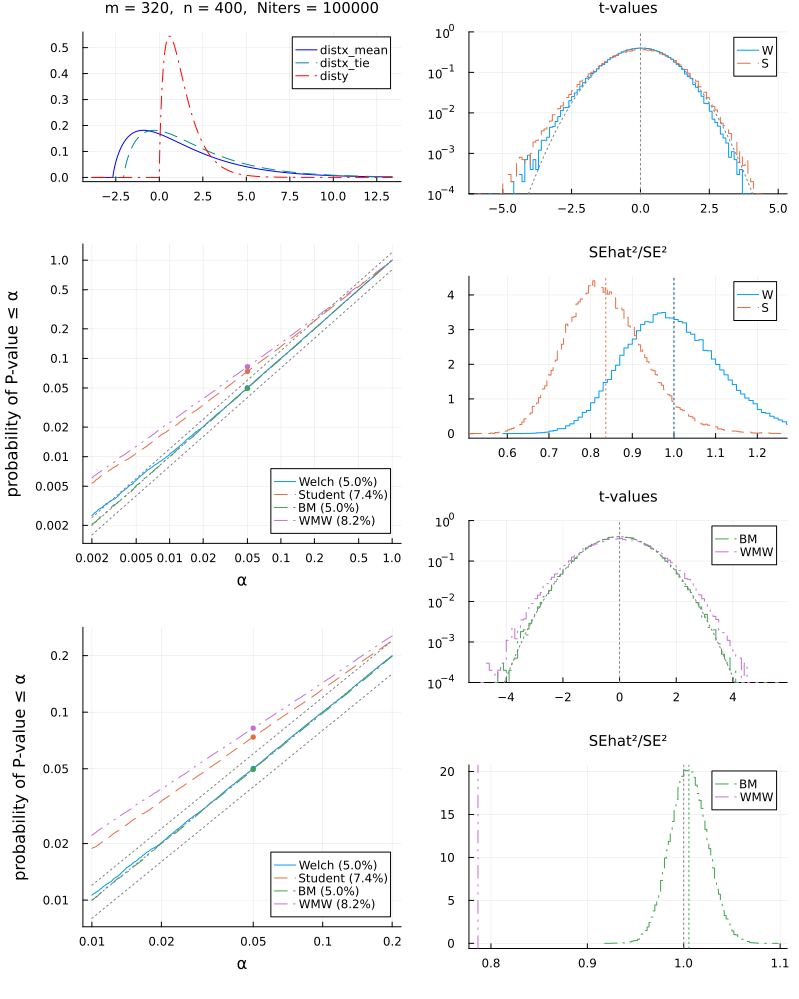

In [44]:
distx = gammadist(3, 1.5)
disty = gammadist(1, 1.5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)


  6.790694 seconds (40.84 M allocations: 1.299 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         1.5         3.4
 disty     3.0         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.05286
  Student t-test:      0.03637
  Brunner-Munzel test: 0.050156
  WMW test:            0.056438



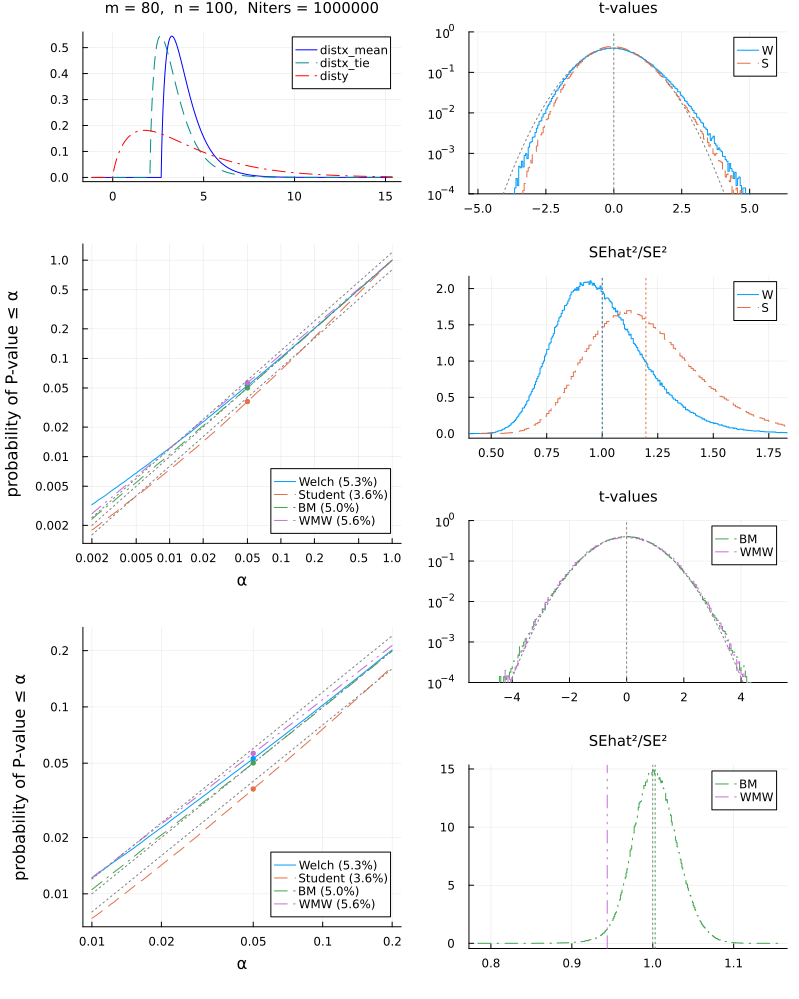

In [45]:
distx = gammadist(1, 1.5)
disty = gammadist(3, 1.5)
plot_sim(; distx, disty, m=80, n=100)


  8.220295 seconds (4.08 M allocations: 132.788 MiB)

           std    skewness    kurtosis
----------------------------------------
 distx     1.0         1.5         3.4
 disty     3.0         1.5         3.4

true α-error rate for α = 0.05
  Welch t-test:        0.05074
  Student t-test:      0.03329
  Brunner-Munzel test: 0.04975
  WMW test:            0.05635



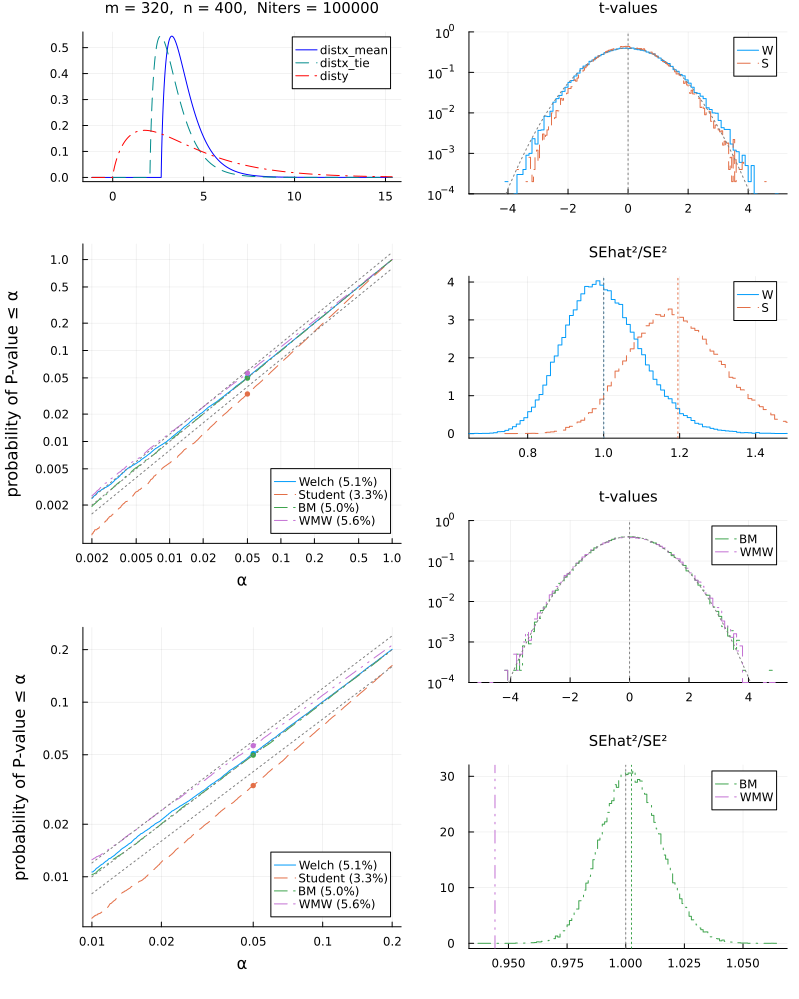

In [46]:
distx = gammadist(1, 1.5)
disty = gammadist(3, 1.5)
plot_sim(; distx, disty, m=320, n=400, L=10^5)

* https://onlinelibrary.wiley.com/doi/10.1002/sim.3561
  * https://onlinelibrary.wiley.com/action/downloadSupplement?doi=10.1002%2Fsim.3561&file=sim_3561_sm_SupplMat.pdf


  1.484629 seconds (35.72 M allocations: 1.398 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.069634
  Student t-test:      0.071143
  Brunner-Munzel test: 0.408499
  WMW test:            0.462211



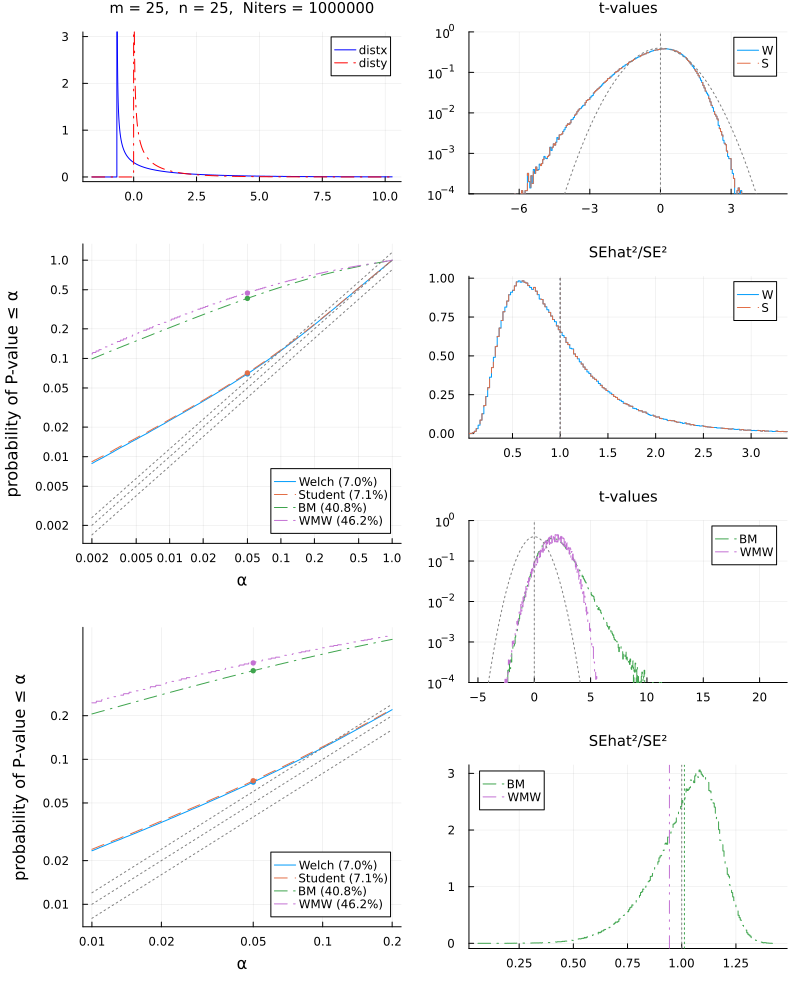

In [49]:
distx = gammadist(2, 3)
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=25, n=25, ylim=(-0.1, 3.1), shifttype=:mean)


  1.534147 seconds (35.73 M allocations: 1.400 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.086523
  Student t-test:      0.093605
  Brunner-Munzel test: 0.084455
  WMW test:            0.096418



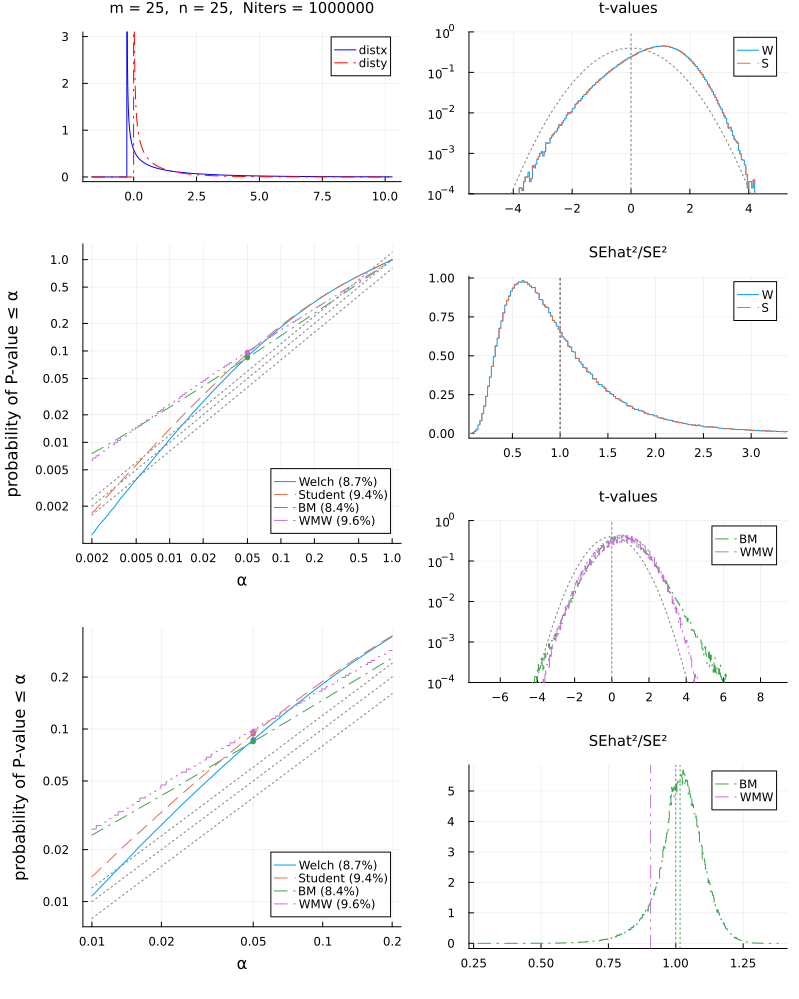

In [50]:
distx = gammadist(2, 3)
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=25, n=25, ylim=(-0.1, 3.1), shifttype=:median)


  1.466674 seconds (36.02 M allocations: 1.484 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.14942
  Student t-test:      0.158876
  Brunner-Munzel test: 0.051751
  WMW test:            0.056579



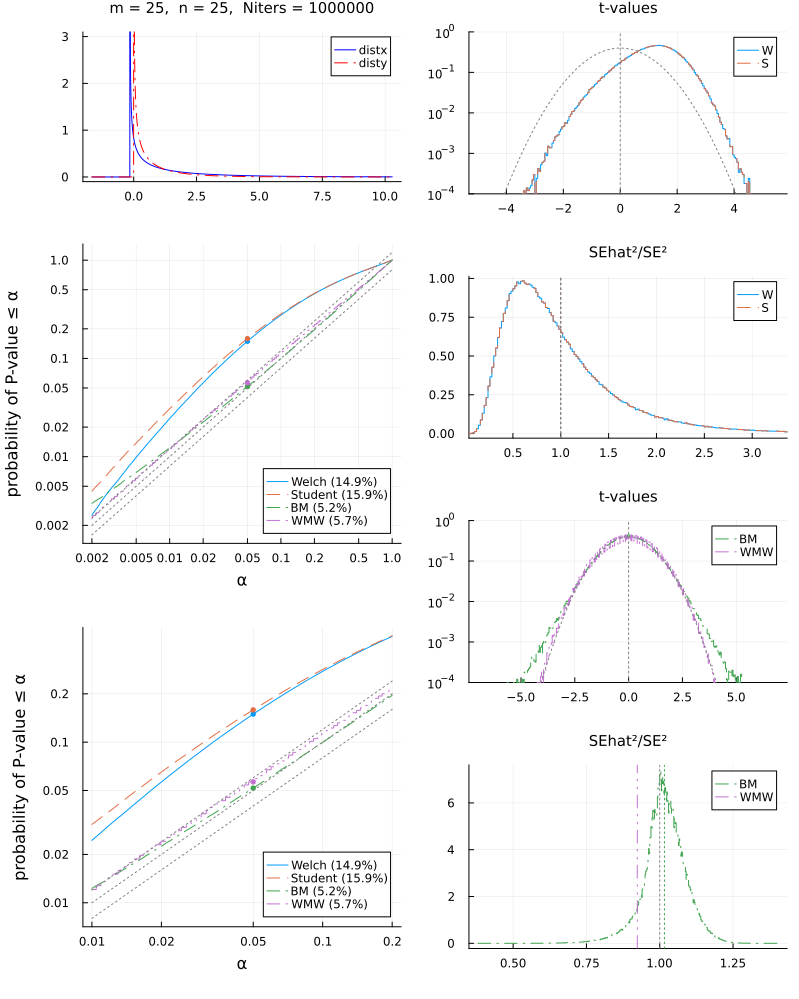

In [52]:
distx = gammadist(2, 3)
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=25, n=25, ylim=(-0.1, 3.1), shifttype=:tie)


  3.879581 seconds (36.04 M allocations: 1.489 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.094228
  Student t-test:      0.187139
  Brunner-Munzel test: 0.421562
  WMW test:            0.62643



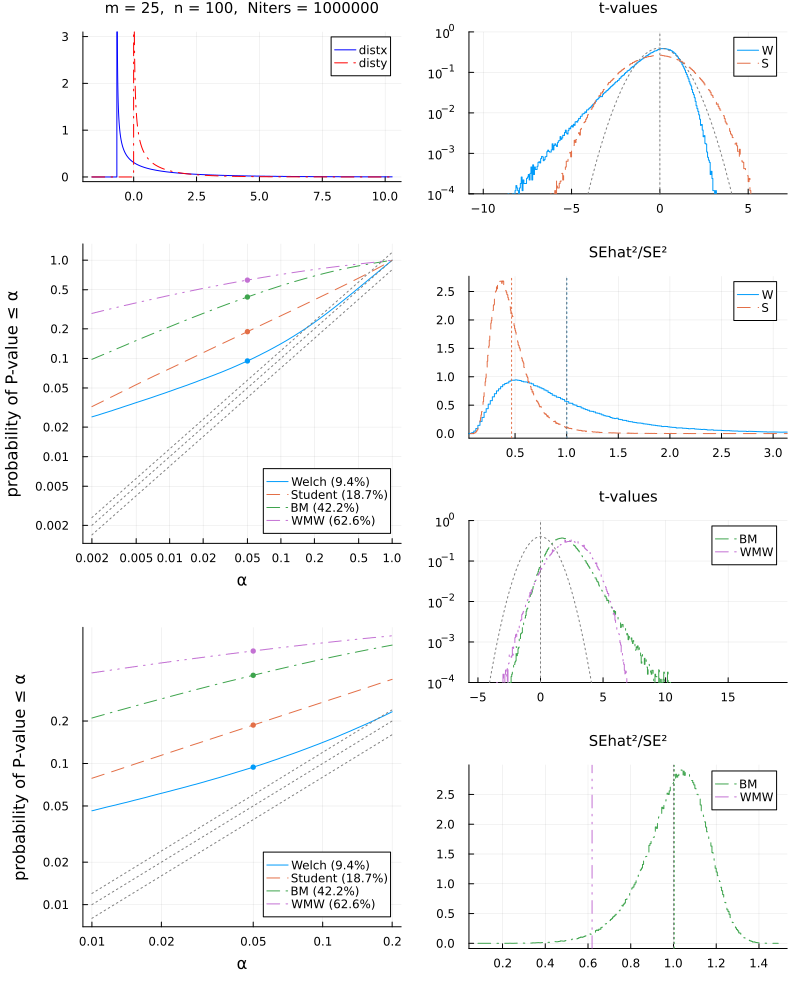

In [51]:
distx = gammadist(2, 3)
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=25, n=100, ylim=(-0.1, 3.1), shifttype=:mean)

tiesh = -0.15274477941518558
mediansh = -0.2711292144816104
meansh = -0.6666666666666666

shifttype = :median
distx = LocationScale{Float64, Continuous, Gamma{Float64}}(
μ: -0.2711292144816104
σ: 1.0
ρ: Gamma{Float64}(α=0.4444444444444444, θ=3.0)
)

winningrate(distx, disty) = 0.5465032452086256
median(distx) = 0.2711292144816104
median(disty) = 0.2711292144816104
mean(distx) = 1.0622041188517228
mean(disty) = 0.6666666666666666

  3.349635 seconds (36.06 M allocations: 1.495 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.07653
  Student t-test:      0.323915
  Brunner-Munzel test: 0.084779
  WMW test:            0.17971

(mean(sehat2_we) / se2, std(sehat2_we) / se2) = (0.9979605712774492, 0.7395066885640523)
(mean(sehat2_st) / se2, std(sehat2_st) / se2) = (0.4657523597336403, 0.20302489127957898)
(mean(sehat2_bm) 

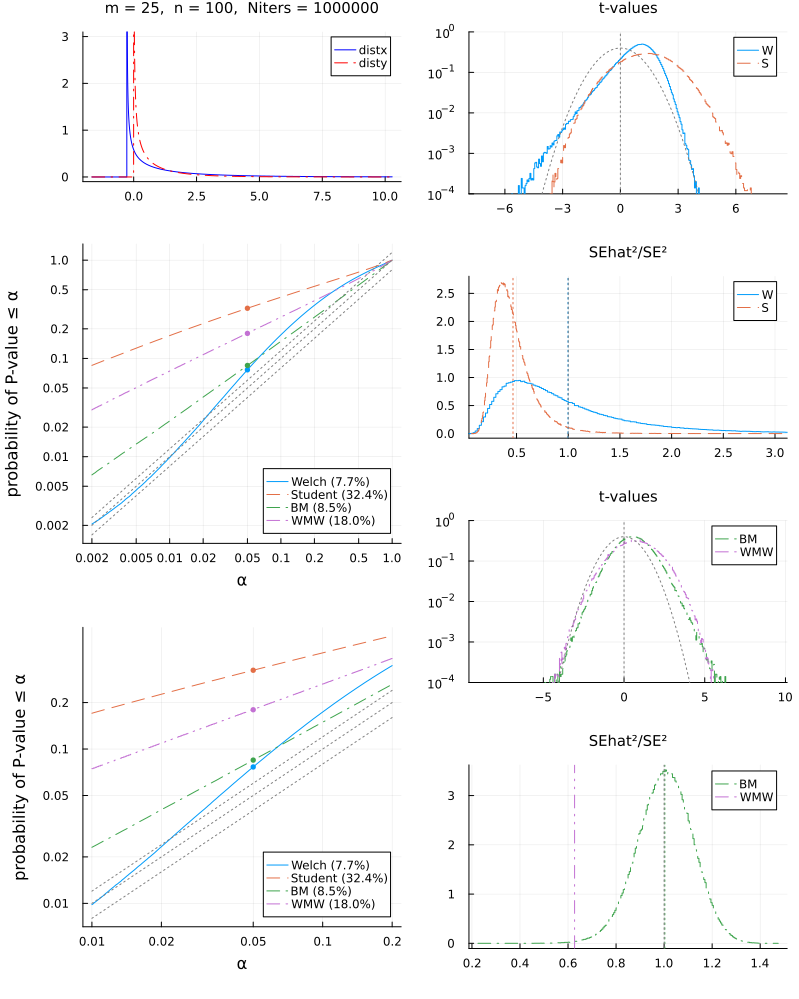

In [57]:
distx = gammadist(2, 3)
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=25, n=100, ylim=(-0.1, 3.1), shifttype=:median, verbose=true)

tiesh = 0.11838443506642485
mediansh = 0.0
meansh = -0.3955374521850562

shifttype = :none
distx = LocationScale{Float64, Continuous, Gamma{Float64}}(
μ: -0.2711292144816104
σ: 1.0
ρ: Gamma{Float64}(α=0.4444444444444444, θ=3.0)
)

winningrate(distx, disty) = 0.5465032452086256
median(distx) = 0.2711292144816104
median(disty) = 0.2711292144816104
mean(distx) = 1.0622041188517228
mean(disty) = 0.6666666666666666

  3.270494 seconds (36.09 M allocations: 1.497 GiB, 24.86% compilation time)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.07613
  Student t-test:      0.323199
  Brunner-Munzel test: 0.084954
  WMW test:            0.18015

(mean(sehat2_we) / se2, std(sehat2_we) / se2) = (1.0000203017622216, 0.7418589199475969)
(mean(sehat2_st) / se2, std(sehat2_st) / se2) = (0.46639918257666113, 0.20358874082905676)
(mean(seha

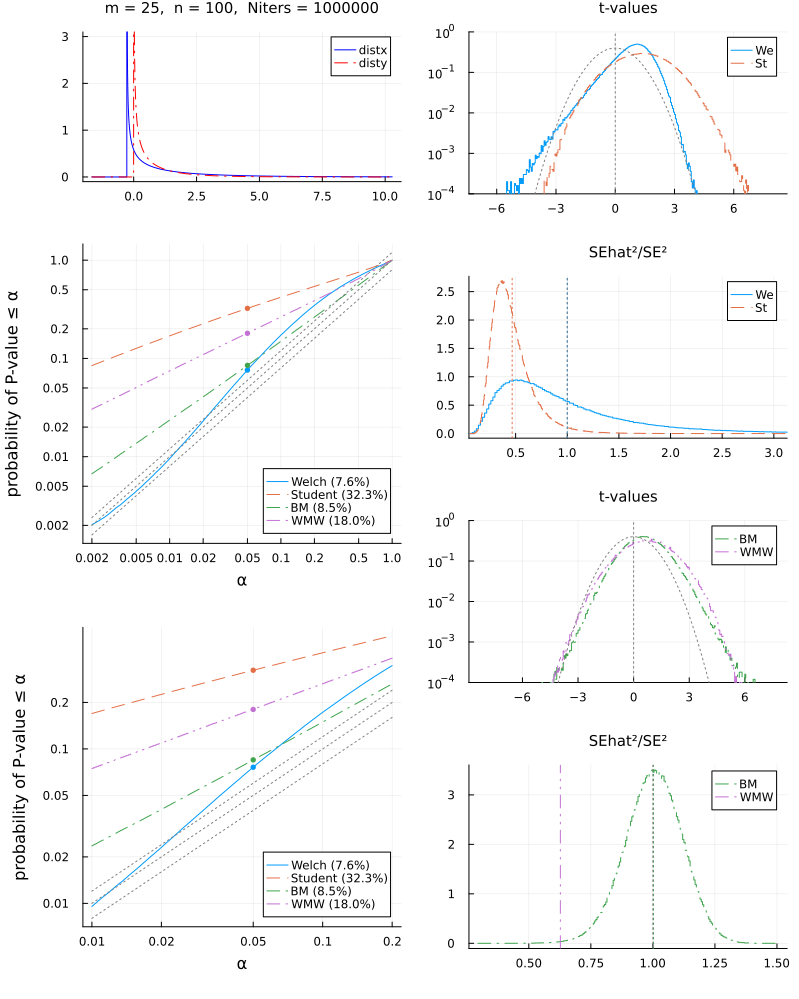

In [59]:
distx = gammadist(2, 3) - 0.2711292144816104
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=25, n=100, ylim=(-0.1, 3.1), shifttype=:none, verbose=true)

tiesh = 0.16038443506642483
mediansh = 0.04199999999999998
meansh = -0.35353745218505617

shifttype = :none
distx = LocationScale{Float64, Continuous, Gamma{Float64}}(
μ: -0.3131292144816104
σ: 1.0
ρ: Gamma{Float64}(α=0.4444444444444444, θ=3.0)
)

winningrate(distx, disty) = 0.5606514060745668
median(distx) = 0.22912921448161044
median(disty) = 0.2711292144816104
mean(distx) = 1.0202041188517228
mean(disty) = 0.6666666666666666

  3.065354 seconds (36.00 M allocations: 1.478 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.064832
  Student t-test:      0.288292
  Brunner-Munzel test: 0.10929
  WMW test:            0.222522

(mean(sehat2_we) / se2, std(sehat2_we) / se2) = (0.9994656049211054, 0.7440272115309916)
(mean(sehat2_st) / se2, std(sehat2_st) / se2) = (0.4661594017199026, 0.20398242559469662)
(mean(sehat2_bm) 

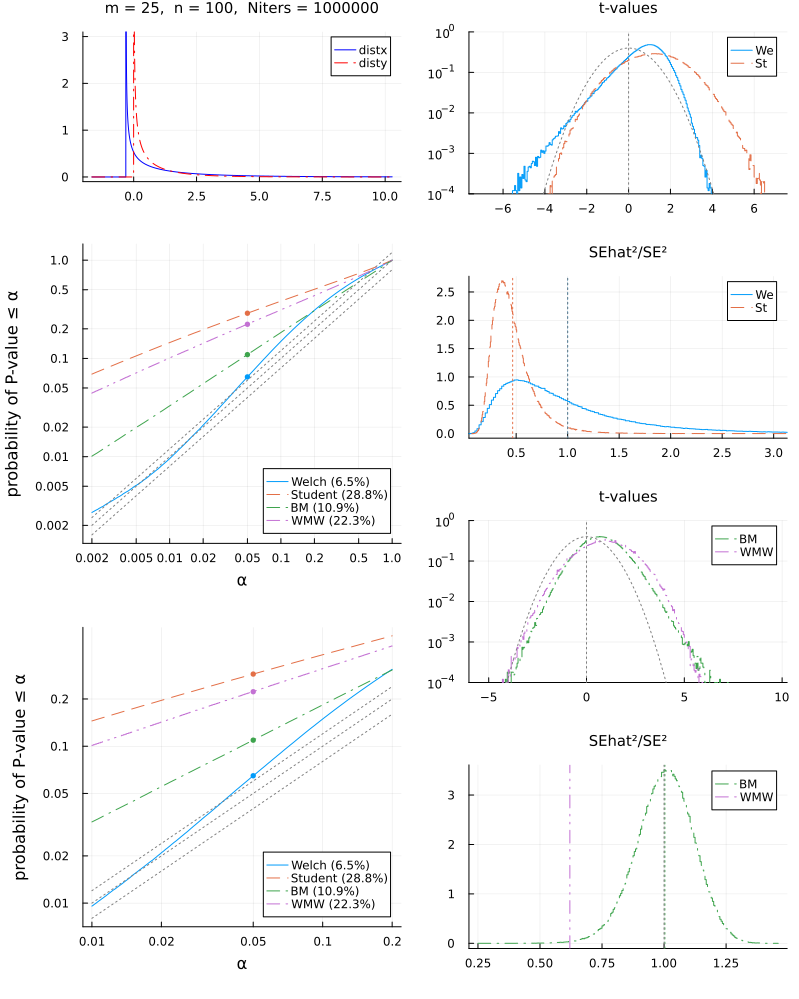

In [74]:
distx = gammadist(2, 3) - 0.2711292144816104 - 0.042
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=25, n=100, ylim=(-0.1, 3.1), shifttype=:none, verbose=true)

tiesh = 0.10838443506642484
mediansh = -0.010000000000000009
meansh = -0.4055374521850562

shifttype = :none
distx = LocationScale{Float64, Continuous, Gamma{Float64}}(
μ: -0.2611292144816104
σ: 1.0
ρ: Gamma{Float64}(α=0.4444444444444444, θ=3.0)
)

winningrate(distx, disty) = 0.5429836003839766
median(distx) = 0.28112921448161043
median(disty) = 0.2711292144816104
mean(distx) = 1.0722041188517228
mean(disty) = 0.6666666666666666

  2.814086 seconds (36.37 M allocations: 1.581 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.349876
  Student t-test:      0.039333
  Brunner-Munzel test: 0.131141
  WMW test:            0.049417

(mean(sehat2_we) / se2, std(sehat2_we) / se2) = (0.9993414358273556, 0.44049284344161893)
(mean(sehat2_st) / se2, std(sehat2_st) / se2) = (2.1322741482836296, 0.796938144422318)
(mean(sehat2_bm)

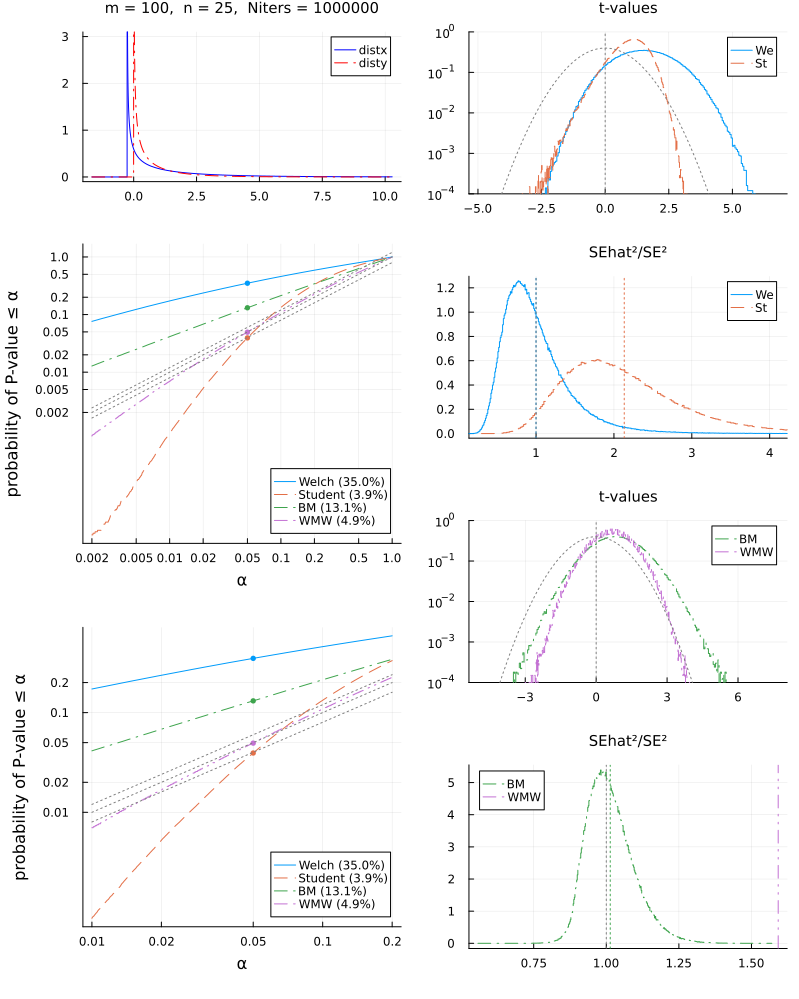

In [83]:
distx = gammadist(2, 3) - 0.2711292144816104 + 0.01
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=100, n=25, ylim=(-0.1, 3.1), shifttype=:none, verbose=true)

tiesh = -0.15274477941518558
mediansh = -0.2711292144816104
meansh = -0.6666666666666666

shifttype = :mean
distx = LocationScale{Float64, Continuous, Gamma{Float64}}(
μ: -0.6666666666666666
σ: 1.0
ρ: Gamma{Float64}(α=0.4444444444444444, θ=3.0)
)

winningrate(distx, disty) = 0.6527211724467342
median(distx) = -0.12440823770344578
median(disty) = 0.2711292144816104
mean(distx) = 0.6666666666666666
mean(disty) = 0.6666666666666666

  3.339154 seconds (35.92 M allocations: 1.455 GiB)

           std    skewness    kurtosis
----------------------------------------
 distx     2.0         3.0        13.5
 disty     1.0         3.0        13.5

true α-error rate for α = 0.05
  Welch t-test:        0.047047
  Student t-test:      0.012372
  Brunner-Munzel test: 0.882312
  WMW test:            0.710244

(mean(sehat2_we) / se2, std(sehat2_we) / se2) = (0.9999293406486868, 0.4402330357627216)
(mean(sehat2_st) / se2, std(sehat2_st) / se2) = (2.133334148426847, 0.7963536149604865)
(mean(sehat2_bm) 

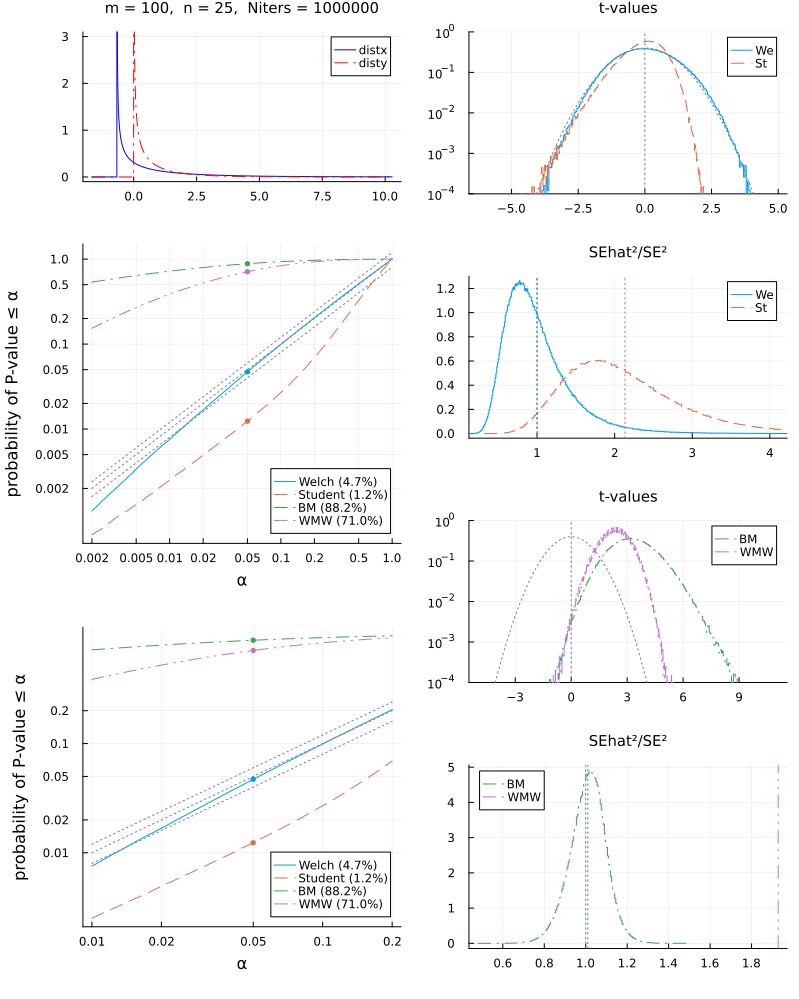

In [77]:
distx = gammadist(2, 3)
disty = gammadist(1, 3)
plot_sim(; distx, disty, m=100, n=25, ylim=(-0.1, 3.1), shifttype=:mean, verbose=true)